In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))

In [2]:
import warnings
warnings.simplefilter("ignore", UserWarning)
warnings.simplefilter("ignore", FutureWarning)
warnings.simplefilter("ignore", RuntimeWarning)

import sys
sys.path.append('../../dstorch/')

import pandas as pd
import seaborn
import matplotlib.pyplot as plt
%matplotlib inline
%reload_ext autoreload
%autoreload 2

In [3]:
from dstorch import io, dataset, transforms, losses, models, predict, draw, utils
from dstorch.train import train
from dstorch.utils import variable
import torch.backends.cudnn as cudnn
import torch
import torch.nn as nn
from torch.optim import Adam
from tqdm import tqdm_notebook, tqdm
import numpy as np
import cv2
import skimage
import os
from skimage.io import imread

In [4]:
classes = pd.read_csv("../../classes.csv")

TRAIN_PATH = '../../kaggle-dsbowl-2018-dataset-fixes/stage1_train/'
TEST_PATH = '../../stage1_test/'

ids = next(os.walk(TRAIN_PATH))[1]
[train_ids], [val_ids] = utils.train_val_split(classes, ids, ids)

In [5]:
train_transforms = transforms.DualCompose(
    [
        transforms.RandomCrop((256, 256)),
        transforms.VerticalFlip(),
        transforms.HorizontalFlip(),
        transforms.Transpose(),
        transforms.ShiftScaleRotate(scale_limit=0.75),
        transforms.Distort1(0.5, 0.5),
        transforms.ImageOnly(transforms.RandomBrightness(0.5)),
        transforms.ImageOnly(transforms.RandomContrast(0.5)),
        transforms.ImageOnly(transforms.Normalize(
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225]
        ))
    ]
)

val_transforms = transforms.DualCompose(
    [
        transforms.ImageOnly(transforms.Normalize(
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225]
        ))
    ]
)

In [6]:
train_args = {
    'model_name': 'test_lr_3',
    'network': 'TernausNet34',
    'nb_epoch': 60, 
    'loss': 'BCEDiceLossCenters',
    'lr': 0.0005, 
    'model_dir': 'models', 
    'log_dir': 'logs', 
    'network_args': {
        'num_classes': 3, 
        'num_filters': 16, 
        'pretrained': True
    }, 
    'loss_args': {
        'weights': {
            'mask': 0.5,
            'center': 0.4,
            'center_04': 0.1
        }
    },       
    'cycle_start_epoch': 5
}

train(
    train_args, train_ids, val_ids, 
    "../../data/images/{}.png", "../../data/masks/{}.png", 
    16, 1, train_transforms, val_transforms, period=64
)

Epoch 0, lr 1e-07: 100% 37/37 [00:11<00:00,  3.12it/s, 0 cls=2.25274, 1 cls=3.36958, 2 cls=2.96060, bce=0.72531, dice=0.14607, loss=2.77026]


loss: 3.51648 | bce: 0.72799 | dice: 0.10788 | 0 cls: 3.00592 | 1 cls: 4.10762 | 2 cls: 3.70842


Epoch 1, lr 1e-07: 100% 37/37 [00:11<00:00,  3.25it/s, 0 cls=2.26755, 1 cls=3.37950, 2 cls=2.97288, bce=0.72547, dice=0.14430, loss=2.78286]


loss: 3.51647 | bce: 0.72799 | dice: 0.10788 | 0 cls: 3.00582 | 1 cls: 4.10773 | 2 cls: 3.70830


Epoch 2, lr 1.5e-07: 100% 37/37 [00:11<00:00,  3.22it/s, 0 cls=2.25561, 1 cls=3.37087, 2 cls=2.96259, bce=0.72536, dice=0.14516, loss=2.77241]


loss: 3.51640 | bce: 0.72793 | dice: 0.10788 | 0 cls: 3.00573 | 1 cls: 4.10768 | 2 cls: 3.70824


Epoch 3, lr 1.5e-07: 100% 37/37 [00:11<00:00,  3.22it/s, 0 cls=2.27028, 1 cls=3.39097, 2 cls=2.98184, bce=0.72547, dice=0.14352, loss=2.78971]


loss: 3.51635 | bce: 0.72790 | dice: 0.10788 | 0 cls: 3.00564 | 1 cls: 4.10769 | 2 cls: 3.70815


Epoch 4, lr 2.25e-07: 100% 37/37 [00:11<00:00,  3.21it/s, 0 cls=2.26297, 1 cls=3.37688, 2 cls=2.96994, bce=0.72529, dice=0.14490, loss=2.77923]


loss: 3.51627 | bce: 0.72784 | dice: 0.10788 | 0 cls: 3.00544 | 1 cls: 4.10779 | 2 cls: 3.70803


Epoch 5, lr 2.25e-07: 100% 37/37 [00:11<00:00,  3.17it/s, 0 cls=2.27138, 1 cls=3.38870, 2 cls=2.98051, bce=0.72541, dice=0.14318, loss=2.78922]


loss: 3.51619 | bce: 0.72779 | dice: 0.10788 | 0 cls: 3.00531 | 1 cls: 4.10775 | 2 cls: 3.70792


Epoch 6, lr 3.375e-07: 100% 37/37 [00:11<00:00,  3.09it/s, 0 cls=2.26941, 1 cls=3.38598, 2 cls=2.97794, bce=0.72528, dice=0.14377, loss=2.78689]


loss: 3.51607 | bce: 0.72768 | dice: 0.10788 | 0 cls: 3.00509 | 1 cls: 4.10775 | 2 cls: 3.70786


Epoch 7, lr 3.375e-07: 100% 37/37 [00:12<00:00,  3.08it/s, 0 cls=2.26966, 1 cls=3.39423, 2 cls=2.98235, bce=0.72524, dice=0.14313, loss=2.79076]


loss: 3.51596 | bce: 0.72762 | dice: 0.10788 | 0 cls: 3.00485 | 1 cls: 4.10784 | 2 cls: 3.70765


Epoch 8, lr 5.0625e-07: 100% 37/37 [00:12<00:00,  3.08it/s, 0 cls=2.25262, 1 cls=3.36512, 2 cls=2.95804, bce=0.72493, dice=0.14587, loss=2.76816]


loss: 3.51576 | bce: 0.72749 | dice: 0.10788 | 0 cls: 3.00452 | 1 cls: 4.10780 | 2 cls: 3.70747


Epoch 9, lr 5.0625e-07: 100% 37/37 [00:12<00:00,  3.07it/s, 0 cls=2.26471, 1 cls=3.38692, 2 cls=2.97567, bce=0.72499, dice=0.14378, loss=2.78469]


loss: 3.51557 | bce: 0.72735 | dice: 0.10788 | 0 cls: 3.00411 | 1 cls: 4.10786 | 2 cls: 3.70725


Epoch 10, lr 7.593749999999999e-07: 100% 37/37 [00:12<00:00,  3.07it/s, 0 cls=2.26011, 1 cls=3.38135, 2 cls=2.97085, bce=0.72484, dice=0.14409, loss=2.77968]


loss: 3.51528 | bce: 0.72717 | dice: 0.10788 | 0 cls: 3.00354 | 1 cls: 4.10792 | 2 cls: 3.70697


Epoch 11, lr 7.593749999999999e-07: 100% 37/37 [00:12<00:00,  3.07it/s, 0 cls=2.25017, 1 cls=3.37008, 2 cls=2.95947, bce=0.72452, dice=0.14558, loss=2.76906]


loss: 3.51496 | bce: 0.72702 | dice: 0.10789 | 0 cls: 3.00299 | 1 cls: 4.10792 | 2 cls: 3.70659


Epoch 12, lr 1.1390625e-06: 100% 37/37 [00:12<00:00,  3.07it/s, 0 cls=2.25724, 1 cls=3.38073, 2 cls=2.96844, bce=0.72433, dice=0.14518, loss=2.77776]


loss: 3.51438 | bce: 0.72671 | dice: 0.10789 | 0 cls: 3.00178 | 1 cls: 4.10808 | 2 cls: 3.70615


Epoch 13, lr 1.1390625e-06: 100% 37/37 [00:12<00:00,  3.07it/s, 0 cls=2.24283, 1 cls=3.36611, 2 cls=2.95471, bce=0.72389, dice=0.14633, loss=2.76333]


loss: 3.51318 | bce: 0.72614 | dice: 0.10788 | 0 cls: 2.99980 | 1 cls: 4.10746 | 2 cls: 3.70637


Epoch 14, lr 1.70859375e-06: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=2.24823, 1 cls=3.37213, 2 cls=2.96553, bce=0.72302, dice=0.14534, loss=2.76952]


loss: 3.50732 | bce: 0.72388 | dice: 0.10779 | 0 cls: 2.98659 | 1 cls: 4.10804 | 2 cls: 3.71135


Epoch 15, lr 1.70859375e-06: 100% 37/37 [00:12<00:00,  3.07it/s, 0 cls=2.21068, 1 cls=3.37865, 2 cls=3.01209, bce=0.71576, dice=0.14330, loss=2.75801]


loss: 3.44481 | bce: 0.70653 | dice: 0.10639 | 0 cls: 2.86806 | 1 cls: 4.07466 | 2 cls: 3.80940


Epoch 16, lr 2.562890625e-06: 100% 37/37 [00:12<00:00,  3.07it/s, 0 cls=1.85950, 1 cls=3.14795, 2 cls=3.54325, bce=0.76358, dice=0.14336, loss=2.54325]


loss: 3.37074 | bce: 0.91270 | dice: 0.10031 | 0 cls: 2.71375 | 1 cls: 3.79870 | 2 cls: 4.94037


Epoch 17, lr 2.562890625e-06: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=1.63167, 1 cls=2.77376, 2 cls=4.30866, bce=0.91126, dice=0.14673, loss=2.35621]


loss: 3.27739 | bce: 0.87430 | dice: 0.10347 | 0 cls: 2.63496 | 1 cls: 3.67628 | 2 cls: 4.90275


Epoch 18, lr 3.8443359375e-06: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=1.59029, 1 cls=2.62982, 2 cls=4.12276, bce=0.82805, dice=0.15193, loss=2.25935]


loss: 3.20654 | bce: 0.71945 | dice: 0.10485 | 0 cls: 2.63527 | 1 cls: 3.60025 | 2 cls: 4.50745


Epoch 19, lr 3.8443359375e-06: 100% 37/37 [00:12<00:00,  3.07it/s, 0 cls=1.54821, 1 cls=2.49762, 2 cls=3.36971, bce=0.58595, dice=0.16336, loss=2.11013]


loss: 3.18706 | bce: 0.39103 | dice: 0.10786 | 0 cls: 2.79790 | 1 cls: 3.59965 | 2 cls: 3.50601


Epoch 20, lr 5.766503906249999e-06: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=1.54689, 1 cls=2.44713, 2 cls=2.20832, bce=0.33528, dice=0.21183, loss=1.97313]


loss: 3.12964 | bce: 0.27659 | dice: 0.11746 | 0 cls: 2.72861 | 1 cls: 3.64966 | 2 cls: 3.10225


Epoch 21, lr 5.766503906249999e-06: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=1.49673, 1 cls=2.36291, 2 cls=1.96736, bce=0.29732, dice=0.23651, loss=1.89027]


loss: 3.08032 | bce: 0.26334 | dice: 0.12441 | 0 cls: 2.63706 | 1 cls: 3.64244 | 2 cls: 3.10474


Epoch 22, lr 8.649755859375e-06: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=1.42876, 1 cls=2.26308, 2 cls=1.86664, bce=0.28207, dice=0.25235, loss=1.80628]


loss: 2.79090 | bce: 0.23543 | dice: 0.14578 | 0 cls: 2.30782 | 1 cls: 3.38531 | 2 cls: 2.85782


Epoch 23, lr 8.649755859375e-06: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=1.36379, 1 cls=2.16302, 2 cls=1.77758, bce=0.26908, dice=0.27038, loss=1.72486]


loss: 2.73845 | bce: 0.22055 | dice: 0.15831 | 0 cls: 2.31612 | 1 cls: 3.25422 | 2 cls: 2.80315


Epoch 24, lr 1.29746337890625e-05: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=1.30909, 1 cls=2.10591, 2 cls=1.71325, bce=0.25902, dice=0.28497, loss=1.66824]


loss: 2.66651 | bce: 0.20210 | dice: 0.17643 | 0 cls: 2.19667 | 1 cls: 3.22870 | 2 cls: 2.75521


Epoch 25, lr 1.29746337890625e-05: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=1.22610, 1 cls=1.98444, 2 cls=1.59305, bce=0.25769, dice=0.32030, loss=1.56613]


loss: 1.95029 | bce: 0.17400 | dice: 0.27579 | 0 cls: 1.36861 | 1 cls: 2.65227 | 2 cls: 2.01012


Epoch 26, lr 1.946195068359375e-05: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=1.34361, 1 cls=1.56297, 2 cls=1.47606, bce=0.39627, dice=0.40803, loss=1.44460]


loss: 2.26641 | bce: 0.15832 | dice: 0.29887 | 0 cls: 1.63515 | 1 cls: 3.05282 | 2 cls: 2.21268


Epoch 27, lr 1.946195068359375e-05: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=0.76667, 1 cls=1.32172, 2 cls=1.11019, bce=0.19903, dice=0.49207, loss=1.02304]


loss: 2.13637 | bce: 0.15758 | dice: 0.32271 | 0 cls: 1.46889 | 1 cls: 2.90736 | 2 cls: 2.32462


Epoch 28, lr 2.9192926025390623e-05: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=0.84361, 1 cls=1.25837, 2 cls=1.08142, bce=0.21733, dice=0.49424, loss=1.03330]


loss: 1.90747 | bce: 0.13216 | dice: 0.36557 | 0 cls: 1.16251 | 1 cls: 2.78051 | 2 cls: 2.07873


Epoch 29, lr 2.9192926025390623e-05: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=0.71366, 1 cls=1.16853, 2 cls=0.99234, bce=0.19857, dice=0.54120, loss=0.92348]


loss: 0.97049 | bce: 0.13899 | dice: 0.52350 | 0 cls: 0.59873 | 1 cls: 1.34106 | 2 cls: 1.31855


Epoch 30, lr 4.3789389038085936e-05: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=0.62109, 1 cls=1.05067, 2 cls=0.87916, bce=0.18742, dice=0.58035, loss=0.81873]


loss: 0.94055 | bce: 0.11479 | dice: 0.54216 | 0 cls: 0.55478 | 1 cls: 1.37838 | 2 cls: 1.08777


Epoch 31, lr 4.3789389038085936e-05: 100% 37/37 [00:12<00:00,  3.07it/s, 0 cls=0.60041, 1 cls=0.98901, 2 cls=0.80977, bce=0.16972, dice=0.60165, loss=0.77679]


loss: 0.99748 | bce: 0.10605 | dice: 0.56669 | 0 cls: 0.55196 | 1 cls: 1.49331 | 2 cls: 1.17354


Epoch 32, lr 6.56840835571289e-05: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=0.52262, 1 cls=0.94469, 2 cls=0.72913, bce=0.15727, dice=0.63544, loss=0.71210]


loss: 0.91437 | bce: 0.08315 | dice: 0.61605 | 0 cls: 0.43903 | 1 cls: 1.51140 | 2 cls: 0.85927


Epoch 33, lr 6.56840835571289e-05: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=0.45052, 1 cls=0.83918, 2 cls=0.64218, bce=0.14033, dice=0.67221, loss=0.62515]


loss: 0.76897 | bce: 0.08214 | dice: 0.65062 | 0 cls: 0.41248 | 1 cls: 1.18300 | 2 cls: 0.85144


Epoch 34, lr 9.852612533569336e-05: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=0.41290, 1 cls=0.78618, 2 cls=0.58760, bce=0.13279, dice=0.69377, loss=0.57968]


loss: 0.66177 | bce: 0.09881 | dice: 0.65222 | 0 cls: 0.54969 | 1 cls: 0.80116 | 2 cls: 0.62808


Epoch 35, lr 9.852612533569336e-05: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=0.39632, 1 cls=0.70717, 2 cls=0.51109, bce=0.12700, dice=0.72178, loss=0.53214]


loss: 0.52658 | bce: 0.07322 | dice: 0.70398 | 0 cls: 0.38394 | 1 cls: 0.70160 | 2 cls: 0.50198


Epoch 36, lr 0.00014778918800354004: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=0.34157, 1 cls=0.63688, 2 cls=0.46289, bce=0.11038, dice=0.74905, loss=0.47182]


loss: 0.72205 | bce: 0.08388 | dice: 0.69606 | 0 cls: 0.42192 | 1 cls: 1.06619 | 2 cls: 0.80677


Epoch 37, lr 0.00014778918800354004: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=0.37335, 1 cls=0.60675, 2 cls=0.44581, bce=0.11556, dice=0.74827, loss=0.47396]


loss: 0.69112 | bce: 0.08853 | dice: 0.70278 | 0 cls: 0.47558 | 1 cls: 0.94301 | 2 cls: 0.72532


Epoch 38, lr 0.00022168378200531006: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=0.37427, 1 cls=0.64165, 2 cls=0.45373, bce=0.12019, dice=0.74526, loss=0.48917]


loss: 0.51272 | bce: 0.07480 | dice: 0.73582 | 0 cls: 0.35599 | 1 cls: 0.71749 | 2 cls: 0.43673


Epoch 39, lr 0.00022168378200531006: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=0.35159, 1 cls=0.58771, 2 cls=0.42806, bce=0.11644, dice=0.76374, loss=0.45368]


loss: 0.45657 | bce: 0.07376 | dice: 0.76096 | 0 cls: 0.30506 | 1 cls: 0.64762 | 2 cls: 0.41706


Epoch 40, lr 0.0003325256730079651: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=0.40247, 1 cls=0.65800, 2 cls=0.47187, bce=0.14089, dice=0.74113, loss=0.51162]


loss: 0.49662 | bce: 0.09649 | dice: 0.72214 | 0 cls: 0.40238 | 1 cls: 0.60296 | 2 cls: 0.49059


Epoch 41, lr 0.0003325256730079651: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=0.33115, 1 cls=0.57482, 2 cls=0.42442, bce=0.10920, dice=0.76565, loss=0.43795]


loss: 0.39282 | bce: 0.06054 | dice: 0.75360 | 0 cls: 0.35333 | 1 cls: 0.44610 | 2 cls: 0.35314


Epoch 42, lr 0.0004987885095119476: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=0.29527, 1 cls=0.54168, 2 cls=0.40383, bce=0.10203, dice=0.78237, loss=0.40469]


loss: 0.63371 | bce: 0.13091 | dice: 0.71948 | 0 cls: 0.56940 | 1 cls: 0.70882 | 2 cls: 0.60459


Epoch 43, lr 0.0004987885095119476: 100% 37/37 [00:12<00:00,  3.05it/s, 0 cls=0.34710, 1 cls=0.56055, 2 cls=0.42117, bce=0.11223, dice=0.76658, loss=0.43989]


loss: 0.40464 | bce: 0.06881 | dice: 0.75780 | 0 cls: 0.37009 | 1 cls: 0.44080 | 2 cls: 0.37615


Epoch 44, lr 0.0007481827642679214: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=0.31611, 1 cls=0.50683, 2 cls=0.39012, bce=0.10388, dice=0.78409, loss=0.39980]


loss: 0.38609 | bce: 0.06163 | dice: 0.76382 | 0 cls: 0.34304 | 1 cls: 0.43716 | 2 cls: 0.35619


Epoch 45, lr 0.0007481827642679214: 100% 37/37 [00:12<00:00,  3.07it/s, 0 cls=0.28763, 1 cls=0.50459, 2 cls=0.38380, bce=0.09815, dice=0.79043, loss=0.38403]


loss: 0.53472 | bce: 0.09133 | dice: 0.73282 | 0 cls: 0.51651 | 1 cls: 0.55610 | 2 cls: 0.49545


Epoch 46, lr 0.001122274146401882: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=0.31673, 1 cls=0.51707, 2 cls=0.40390, bce=0.10643, dice=0.78033, loss=0.40558]


loss: 0.61247 | bce: 0.13083 | dice: 0.73316 | 0 cls: 0.56067 | 1 cls: 0.66006 | 2 cls: 0.56807


Epoch 47, lr 0.001122274146401882: 100% 37/37 [00:12<00:00,  3.07it/s, 0 cls=0.32542, 1 cls=0.52871, 2 cls=0.40728, bce=0.11026, dice=0.77848, loss=0.41492]


loss: 0.54171 | bce: 0.09528 | dice: 0.70971 | 0 cls: 0.49946 | 1 cls: 0.58218 | 2 cls: 0.48298


Epoch 48, lr 0.0016834112196028232: 100% 37/37 [00:12<00:00,  3.07it/s, 0 cls=0.35117, 1 cls=0.55505, 2 cls=0.44297, bce=0.11746, dice=0.76394, loss=0.44190]


loss: 0.66099 | bce: 0.13852 | dice: 0.68577 | 0 cls: 0.58057 | 1 cls: 0.73691 | 2 cls: 0.61451


Epoch 49, lr 0.0016834112196028232: 100% 37/37 [00:12<00:00,  3.07it/s, 0 cls=0.35932, 1 cls=0.54603, 2 cls=0.43844, bce=0.11732, dice=0.76215, loss=0.44192]


loss: 0.63344 | bce: 0.11539 | dice: 0.69064 | 0 cls: 0.67660 | 1 cls: 0.58982 | 2 cls: 0.52723


Epoch 50, lr 0.002525116829404235: 100% 37/37 [00:12<00:00,  3.08it/s, 0 cls=0.35270, 1 cls=0.56777, 2 cls=0.45496, bce=0.11922, dice=0.75935, loss=0.44895]


loss: 0.86614 | bce: 0.18410 | dice: 0.62963 | 0 cls: 0.77661 | 1 cls: 0.92976 | 2 cls: 0.83945


Epoch 51, lr 0.002525116829404235: 100% 37/37 [00:12<00:00,  3.07it/s, 0 cls=0.35178, 1 cls=0.52238, 2 cls=0.43064, bce=0.11670, dice=0.76839, loss=0.42791]


loss: 1.30786 | bce: 0.29540 | dice: 0.45343 | 0 cls: 1.32351 | 1 cls: 1.33618 | 2 cls: 1.29278


Epoch 52, lr 0.003787675244106352: 100% 37/37 [00:12<00:00,  3.07it/s, 0 cls=0.46946, 1 cls=0.62758, 2 cls=0.55058, bce=0.16428, dice=0.72905, loss=0.54082]


loss: 0.65156 | bce: 0.14494 | dice: 0.69348 | 0 cls: 0.58299 | 1 cls: 0.69274 | 2 cls: 0.62771


Epoch 53, lr 0.003787675244106352: 100% 37/37 [00:12<00:00,  3.08it/s, 0 cls=0.42715, 1 cls=0.61956, 2 cls=0.49246, bce=0.14213, dice=0.73596, loss=0.51064]


loss: 1.58670 | bce: 0.32522 | dice: 0.38896 | 0 cls: 1.87197 | 1 cls: 1.26187 | 2 cls: 1.35444


Epoch 54, lr 0.005681512866159528: 100% 37/37 [00:12<00:00,  3.06it/s, 0 cls=0.63078, 1 cls=0.69737, 2 cls=0.63060, bce=0.20708, dice=0.68644, loss=0.65740]


loss: 2.59592 | bce: 0.52599 | dice: 0.20547 | 0 cls: 3.29283 | 1 cls: 1.85989 | 2 cls: 2.07976


Epoch 55, lr 0.005681512866159528: 100% 37/37 [00:12<00:00,  3.08it/s, 0 cls=0.34209, 1 cls=0.57016, 2 cls=0.46068, bce=0.12002, dice=0.76005, loss=0.44518]


loss: 0.72395 | bce: 0.16409 | dice: 0.66070 | 0 cls: 0.62226 | 1 cls: 0.83726 | 2 cls: 0.69681


Epoch 56, lr 0.008522269299239292: 100% 37/37 [00:11<00:00,  3.08it/s, 0 cls=0.33700, 1 cls=0.56146, 2 cls=0.45210, bce=0.12097, dice=0.76619, loss=0.43830]


loss: 0.57410 | bce: 0.08197 | dice: 0.69077 | 0 cls: 0.53000 | 1 cls: 0.61467 | 2 cls: 0.55946


Epoch 57, lr 0.008522269299239292: 100% 37/37 [00:11<00:00,  3.09it/s, 0 cls=0.33261, 1 cls=0.54592, 2 cls=0.43580, bce=0.11335, dice=0.76919, loss=0.42825]


loss: 0.69124 | bce: 0.11865 | dice: 0.65345 | 0 cls: 0.61846 | 1 cls: 0.76827 | 2 cls: 0.66424


Epoch 58, lr 0.012783403948858938: 100% 37/37 [00:11<00:00,  3.09it/s, 0 cls=0.34553, 1 cls=0.57595, 2 cls=0.46667, bce=0.12489, dice=0.76104, loss=0.44981]


loss: 0.91055 | bce: 0.13511 | dice: 0.51640 | 0 cls: 1.03034 | 1 cls: 0.76420 | 2 cls: 0.77107


Epoch 59, lr 0.012783403948858938: 100% 37/37 [00:11<00:00,  3.08it/s, 0 cls=0.35031, 1 cls=0.56020, 2 cls=0.45315, bce=0.12487, dice=0.76362, loss=0.44455]


loss: 0.48226 | bce: 0.08362 | dice: 0.74855 | 0 cls: 0.45264 | 1 cls: 0.50280 | 2 cls: 0.47365
Finished: best loss 0.38609 on epoch 44


In [74]:
model = models.TernausNet34(num_classes=3, num_filters=16, pretrained=True)
loss = losses.BCEDiceLossCenters(weights={
    'mask': 0.5,
    'center': 0.4,
    'center_04': 0.1,
})

if torch.cuda.is_available():
    model = nn.DataParallel(model).cuda()
    cudnn.benchmark = True

In [59]:
val_losses = train(
    init_optimizer=lambda lr: Adam(model.parameters(), lr=lr),
    model=model,
    criterion=loss,
    train_loader=train_loader,
    val_loader=val_loader,
    n_epochs=50, 
    batch_size=16
)

Epoch 2, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.17980


Epoch 2, lr 5e-05: : 597it [00:10, 58.14it/s, loss=0.21574]                       
Epoch 3, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.17767


Epoch 3, lr 5e-05: : 597it [00:10, 57.98it/s, loss=0.29548]                       
Epoch 4, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18143


Epoch 4, lr 5e-05: : 597it [00:10, 57.81it/s, loss=0.20182]                       
Epoch 5, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18037


Epoch 5, lr 5e-05: : 597it [00:10, 58.02it/s, loss=0.22196]                       
Epoch 6, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18004


Epoch 6, lr 5e-05: : 597it [00:10, 57.81it/s, loss=0.19913]                       
Epoch 7, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.17973


Epoch 7, lr 5e-05: : 597it [00:10, 57.28it/s, loss=0.19358]                       
Epoch 8, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18781


Epoch 8, lr 5e-05: : 597it [00:10, 55.80it/s, loss=0.21319]                       
Epoch 9, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18133


Epoch 9, lr 5e-05: : 597it [00:10, 55.42it/s, loss=0.22370]                       
Epoch 10, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18107


Epoch 10, lr 5e-05: : 597it [00:10, 55.37it/s, loss=0.22821]                       
Epoch 11, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.17956


Epoch 11, lr 5e-05: : 597it [00:10, 55.35it/s, loss=0.20184]                       
Epoch 12, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.17975


Epoch 12, lr 5e-05: : 597it [00:10, 55.21it/s, loss=0.22070]                       
Epoch 13, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.17946


Epoch 13, lr 5e-05: : 597it [00:10, 55.19it/s, loss=0.19118]                       
Epoch 14, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.17818


Epoch 14, lr 5e-05: : 597it [00:10, 55.18it/s, loss=0.20397]                       
Epoch 15, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.17919


Epoch 15, lr 5e-05: : 597it [00:10, 55.19it/s, loss=0.19922]                       
Epoch 16, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.17977


Epoch 16, lr 5e-05: : 597it [00:10, 55.25it/s, loss=0.20809]                       
Epoch 17, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18011


Epoch 17, lr 5e-05: : 597it [00:10, 55.03it/s, loss=0.19839]                       
Epoch 18, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18230


Epoch 18, lr 5e-05: : 597it [00:10, 55.15it/s, loss=0.20703]                       
Epoch 19, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18041


Epoch 19, lr 5e-05: : 597it [00:10, 55.17it/s, loss=0.19037]                       
Epoch 20, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18017


Epoch 20, lr 5e-05: : 597it [00:10, 55.19it/s, loss=0.21015]                       
Epoch 21, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18132


Epoch 21, lr 5e-05: : 597it [00:10, 55.32it/s, loss=0.21440]                       
Epoch 22, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18228


Epoch 22, lr 5e-05: : 597it [00:10, 55.32it/s, loss=0.20232]                       
Epoch 23, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18143


Epoch 23, lr 5e-05: : 597it [00:10, 55.31it/s, loss=0.21207]                       
Epoch 24, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18199


Epoch 24, lr 5e-05: : 597it [00:10, 55.16it/s, loss=0.21915]                       
Epoch 25, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18109


Epoch 25, lr 5e-05: : 597it [00:10, 55.24it/s, loss=0.19959]                       
Epoch 26, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18122


Epoch 26, lr 5e-05: : 597it [00:10, 55.19it/s, loss=0.19797]                       
Epoch 27, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18374


Epoch 27, lr 5e-05: : 597it [00:10, 55.27it/s, loss=0.18533]                       
Epoch 28, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18001


Epoch 28, lr 5e-05: : 597it [00:10, 55.31it/s, loss=0.21015]                       
Epoch 29, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18143


Epoch 29, lr 5e-05: : 597it [00:10, 55.07it/s, loss=0.20130]                       
Epoch 30, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18163


Epoch 30, lr 5e-05: : 597it [00:10, 55.13it/s, loss=0.20177]                       
Epoch 31, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18140


Epoch 31, lr 5e-05: : 597it [00:10, 55.26it/s, loss=0.19220]                       
Epoch 32, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18020


Epoch 32, lr 5e-05: : 597it [00:10, 55.25it/s, loss=0.21513]                       
Epoch 33, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18276


Epoch 33, lr 5e-05: : 597it [00:10, 55.30it/s, loss=0.22743]                       
Epoch 34, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.17992


Epoch 34, lr 5e-05: : 597it [00:10, 55.21it/s, loss=0.19087]                       
Epoch 35, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18396


Epoch 35, lr 5e-05: : 597it [00:10, 55.24it/s, loss=0.20198]                       
Epoch 36, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18105


Epoch 36, lr 5e-05: : 597it [00:10, 55.20it/s, loss=0.21650]                       
Epoch 37, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18117


Epoch 37, lr 5e-05: : 597it [00:10, 55.10it/s, loss=0.20872]                       
Epoch 38, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18218


Epoch 38, lr 5e-05: : 597it [00:10, 55.29it/s, loss=0.22272]                       
Epoch 39, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.17916


Epoch 39, lr 5e-05: : 597it [00:10, 55.14it/s, loss=0.21572]                       
Epoch 40, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18090


Epoch 40, lr 5e-05: : 597it [00:10, 55.37it/s, loss=0.20794]                       
Epoch 41, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.17948


Epoch 41, lr 5e-05: : 597it [00:10, 55.32it/s, loss=0.20347]                       
Epoch 42, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18207


Epoch 42, lr 5e-05: : 597it [00:10, 55.12it/s, loss=0.21987]                       
Epoch 43, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.17946


Epoch 43, lr 5e-05: : 597it [00:10, 55.37it/s, loss=0.19922]                       
Epoch 44, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.17894


Epoch 44, lr 5e-05: : 597it [00:10, 55.26it/s, loss=0.19436]                       
Epoch 45, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18412


Epoch 45, lr 5e-05: : 597it [00:10, 55.17it/s, loss=0.21251]                       
Epoch 46, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18112


Epoch 46, lr 5e-05: : 597it [00:10, 55.34it/s, loss=0.20046]                       
Epoch 47, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18176


Epoch 47, lr 5e-05: : 597it [00:10, 55.23it/s, loss=0.20305]                       
Epoch 48, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18063


Epoch 48, lr 5e-05: : 597it [00:10, 55.26it/s, loss=0.18771]                       
Epoch 49, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18241


Epoch 49, lr 5e-05: : 597it [00:10, 55.33it/s, loss=0.19757]                       
Epoch 50, lr 5e-05:   0%|          | 0/190 [00:00<?, ?it/s]

Valid loss: 0.18087


Epoch 50, lr 5e-05: : 597it [00:10, 55.19it/s, loss=0.21206]                       


Valid loss: 0.18110


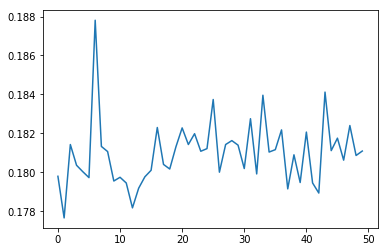

In [60]:
plt.plot(val_losses)

In [55]:
torch.save({
        'model': model.state_dict()
    }, str('../../models/loss_cyclic_best_full.pt'))

In [10]:
val_transform = transforms.DualCompose(
    [
        transforms.ImageOnly(transforms.Normalize(
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225]))
    ]
)

val_predictions, val_names = predict.predict(model, val_ids, "../../data/images/{}.png", val_transform, 1, 2)

Predict: 100%|██████████| 67/67 [00:07<00:00,  9.11it/s]


In [11]:
val_images = []
for _id in tqdm(val_names):
    val_images.append(cv2.imread("../../data/images/{}.png".format(_id)))

val_masks = []
for _id in tqdm(val_names):
    val_masks.append(cv2.imread("../../data/masks/{}.png".format(_id)))

100%|██████████| 67/67 [00:00<00:00, 543.10it/s]


In [12]:
rles = pd.read_csv("../../stage1_train_labels.csv")
val_labels = utils.rles2labels(rles, [x[..., 0].shape for x in val_masks], val_names)

100%|██████████| 67/67 [00:02<00:00, 30.30it/s]


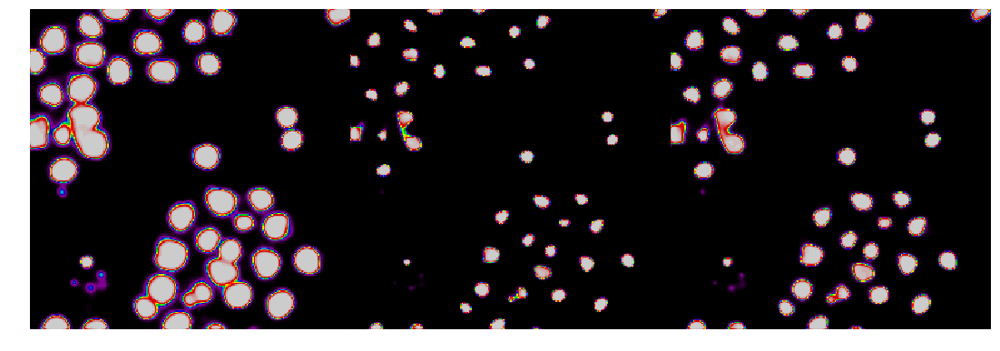

In [13]:
draw.plots([val_predictions[0][..., 0], val_predictions[0][..., 1], val_predictions[0][..., 2]])

In [16]:
import cv2
import numpy as np
import scipy.ndimage as nd
from skimage import img_as_bool, img_as_ubyte
from skimage import morphology
from skimage.feature import peak_local_max
from skimage.filters import gaussian


def remove_smalls(mask, width_holes, width_objects):
    remove_holes = morphology.remove_small_holes(
        mask.astype(bool),
        min_size=width_holes ** 3
    )
    
    remove_objects = morphology.remove_small_objects(
        remove_holes.astype(bool),
        min_size=width_objects ** 3
    )
    return remove_holes, remove_objects


def distance_transform(mask, sigma):
    distance = nd.distance_transform_edt(mask)
    distance = gaussian(distance, sigma=sigma)
    return distance


def pad_zero(image, padding_size, padding=True):
    h, w = image.shape
    if padding:
        padded_image = np.zeros((h + 2 * padding_size, w + 2 * padding_size), dtype=image.dtype)
        padded_image[padding_size:padding_size + h, padding_size:padding_size + w] = image
        return padded_image
    else:
        return image[padding_size:-padding_size, padding_size:-padding_size]


def watershed(
        prediction,
        mask_threshold=0.7,
        center_threshold=0.7,
        width_holes=4,
        width_objects=3,
        sigma=3,
        padding_size=5,
        min_size=50,
        footprint=np.ones((3, 3))
):
    pred_mask  = prediction[..., 0]
    pred_center = prediction[..., 1]

    mask = img_as_ubyte(pred_mask > mask_threshold)
    center = img_as_ubyte(pred_center > center_threshold)
    _, mask = remove_smalls(mask, width_holes, width_objects)

    markers = nd.label(pad_zero(center, 5))[0]
    
    watershed_image = pad_zero(
        morphology.watershed(-pad_zero(
            pred_mask, padding_size=padding_size
        ), 
        markers, mask=pad_zero(mask, padding_size=padding_size)),
        padding_size=padding_size, padding=False
    )
    
    unique, counts = np.unique(watershed_image, return_counts=True)
    for (k, v) in dict(zip(unique, counts)).items():
        if v < min_size:
            watershed_image[watershed_image == k] = 0
    return watershed_image


def get_labels(labeled_image):
    labels = []
    for i in np.unique(labeled_image):
        if i:
            mask = labeled_image == i
            labels.append(mask)
    return np.array(labels)

In [17]:
import numpy as np
import tensorflow as tf
from keras import backend as K
from keras.losses import binary_crossentropy
from tqdm import tqdm_notebook
from collections import defaultdict

def get_ious(y_true, y_pred):
    ious = []
    for prediction in y_pred:
        max_intersection = 0
        max_union = 1e-9
        for ground_truth in y_true:
            intersection = np.sum(prediction * ground_truth)
            if intersection > max_intersection:
                max_intersection = intersection
                max_union = np.sum(np.maximum(prediction, ground_truth))
        ious.append(max_intersection / max_union)
    return ious

def local_mean_iou(y_true, y_pred):
    p = 0
    num_true, num_pred = len(y_true), len(y_pred)

    ious = get_ious(y_true, y_pred)
    for t in np.arange(0.5, 1.0, 0.05):
        matches = ious > t
        tp = np.count_nonzero(matches)
        fp = num_pred - tp
        fn = num_true - tp
        p += tp / (tp + fp + fn)
    return p / 10


def get_scores(gt_labels, name2predictions):
    name2scores = defaultdict(list)
    for i, gt_label in tqdm_notebook(enumerate(gt_labels), total=len(gt_labels)):
        for name, pred in name2predictions.items():
            score = local_mean_iou(gt_label, pred[i])
            name2scores[name].append(score)
            print("{}: {}: {}, mean: {}".format(i, name, score, np.mean(name2scores[name])))
    return name2scores


Using TensorFlow backend.


0.3706069048789512 0.370606904879


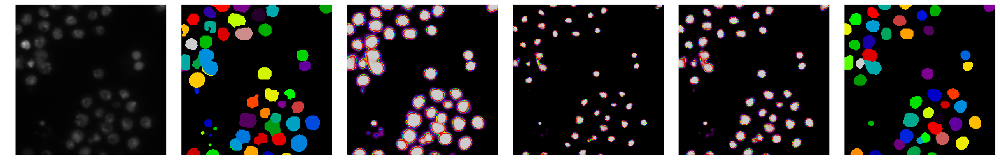

0.9428571428571428 0.656732023868


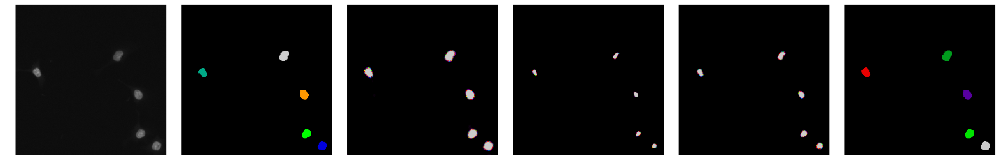

0.8027777777777778 0.705413941838


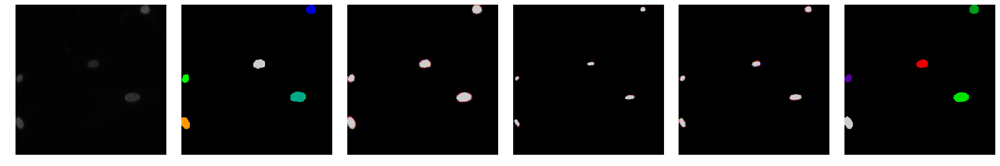

0.47652280980330397 0.648191158829


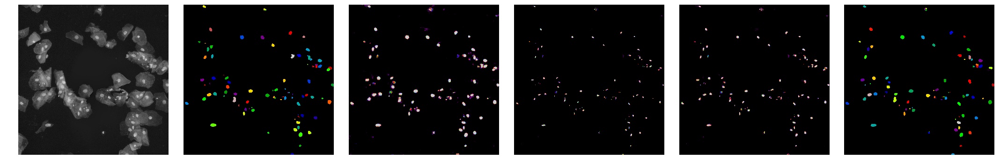

0.7951545530492898 0.677583837673


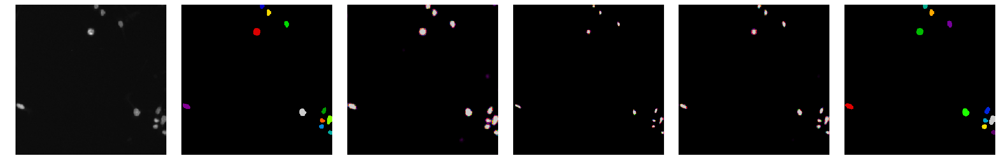

0.9207161125319694 0.718105883483


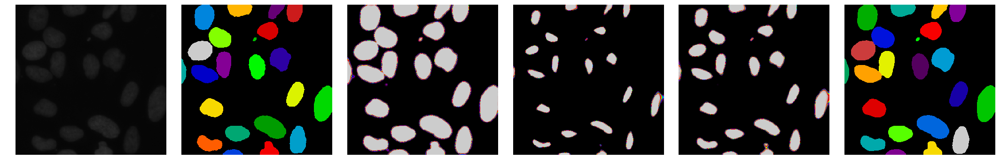

0.43633013112980124 0.677852204575


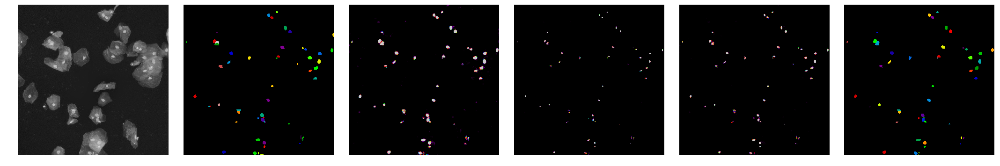

0.8138528138528139 0.694852280735


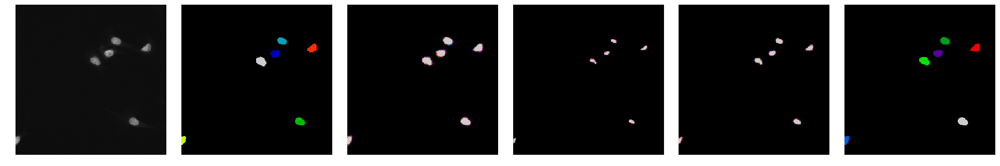

0.4594750875467389 0.66869925927


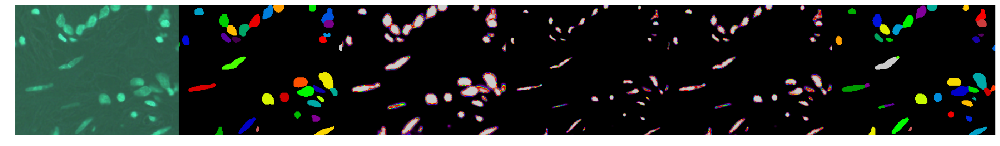

0.8813712374581941 0.689966457089


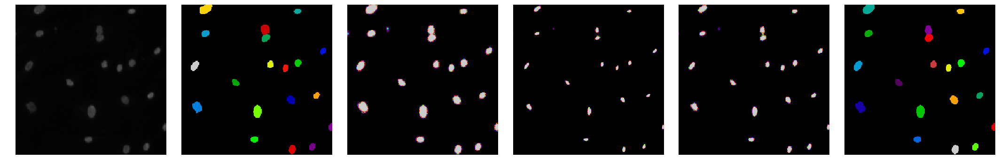

0.27480392156862743 0.652224408405


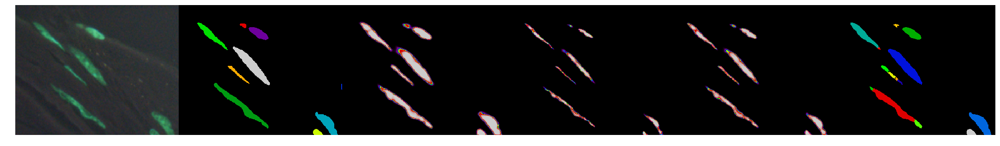

0.7842159433724316 0.663223702986


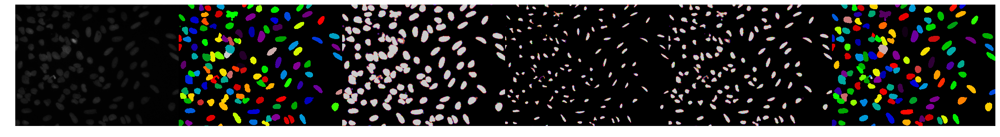

0.915 0.682591110448


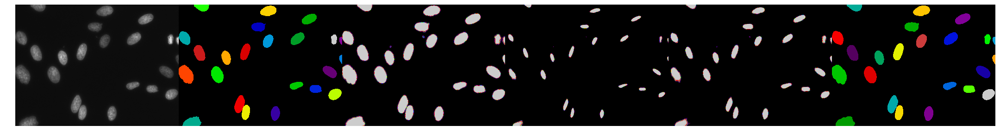

0.3985710322898329 0.662303962008


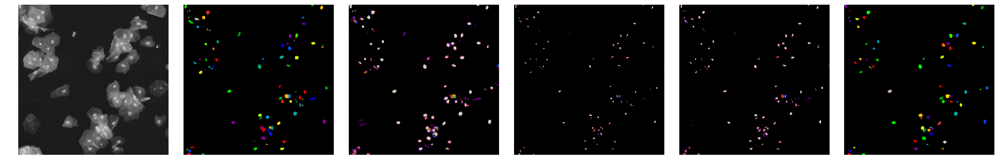

0.5749082925176296 0.656477584042


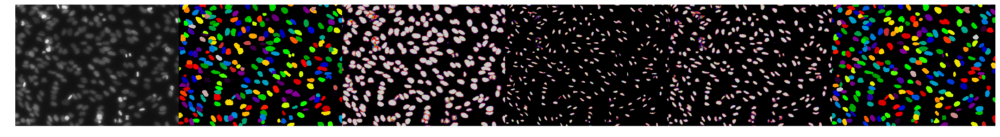

0.3412756977106915 0.636777466147


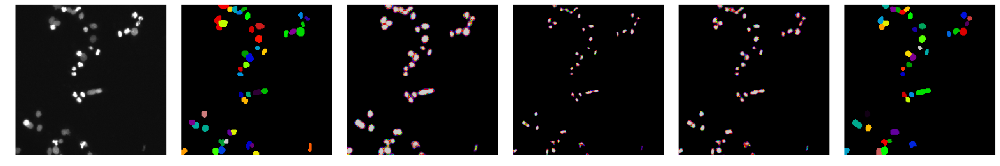

0.5533867718650328 0.631872131189


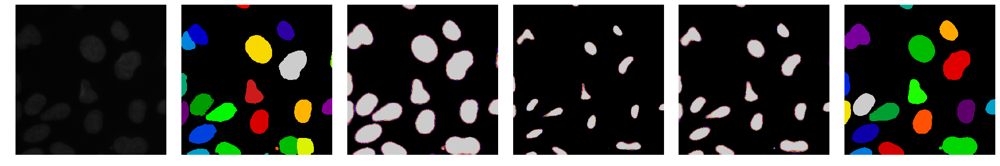

0.17241896197659953 0.606346955121


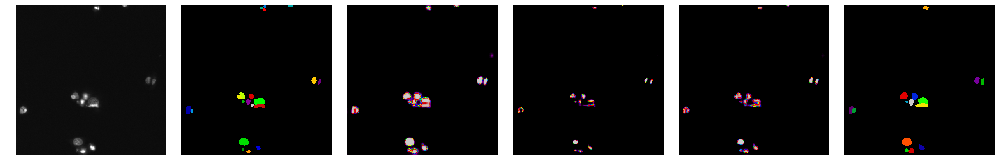

0.4494444444444444 0.598088928244


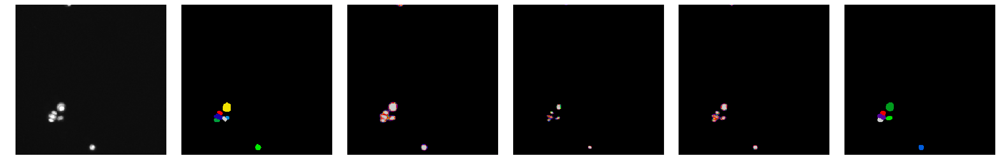

0.3674786324786325 0.586558413455


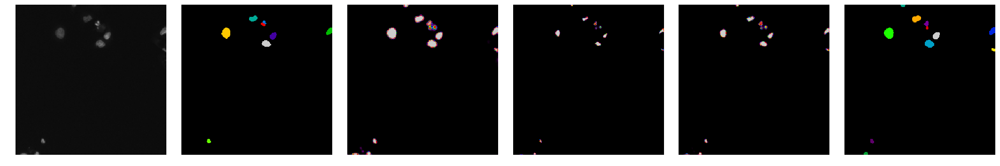

0.49945626394854703 0.58241069205


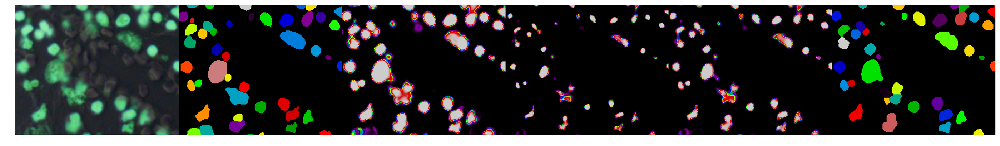

0.7375 0.589460206048


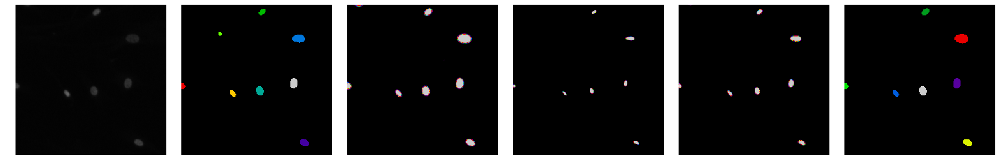

0.31690592502694204 0.577610019917


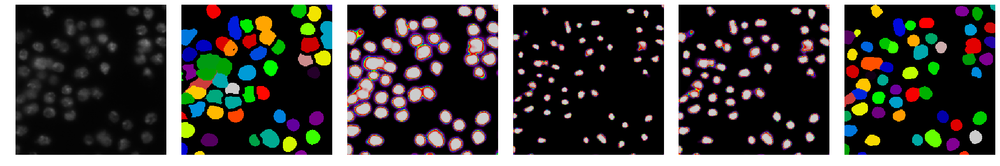

0.6840336134453782 0.582044336314


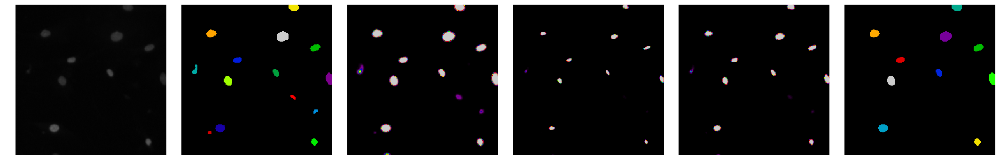

0.8639705882352942 0.593321386391


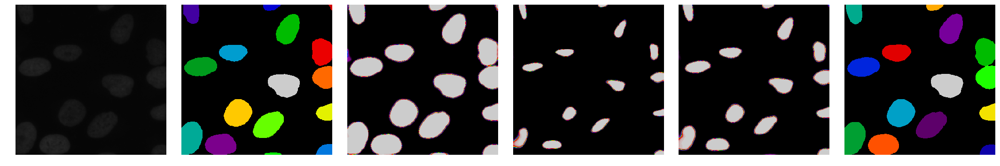

0.8274285714285714 0.602325508892


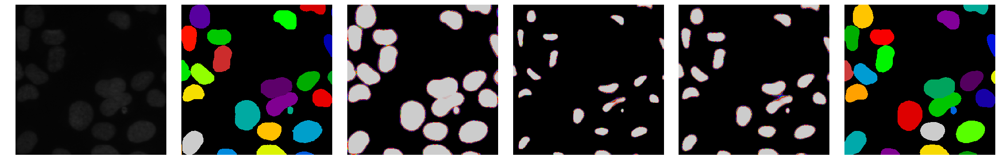

0.6292854996610809 0.603324027069


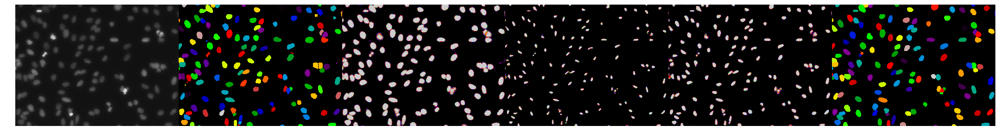

0.3313910524735551 0.593612135119


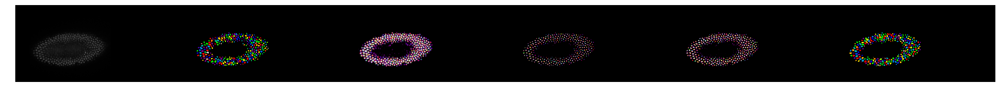

0.3097895457094145 0.583825149277


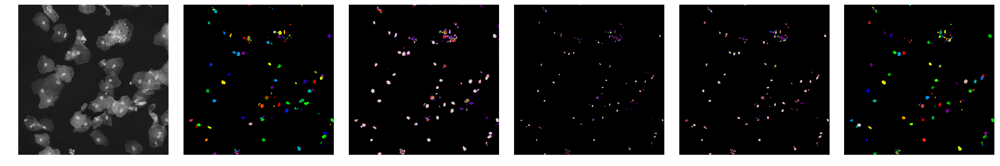

0.7636363636363636 0.589818856423


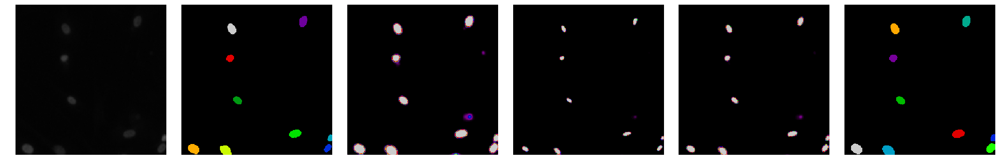

0.8059615384615384 0.596791201004


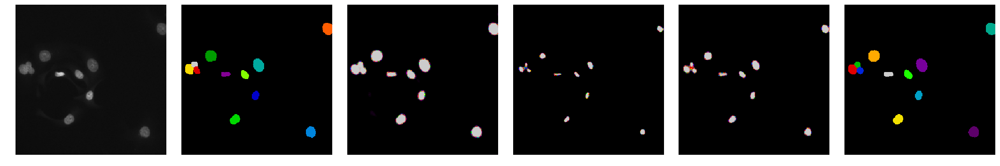

0.2403461925808576 0.585652294491


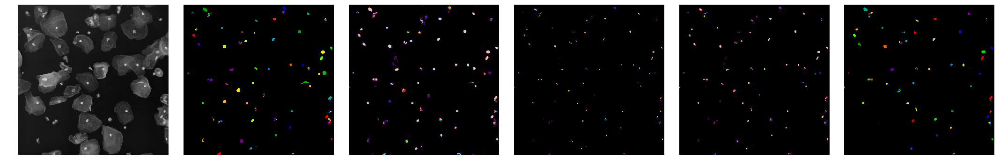

0.9142857142857143 0.59561088297


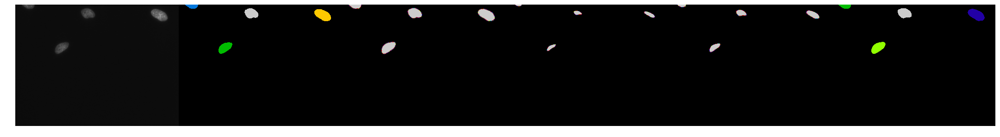

0.5581410239018966 0.594508828291


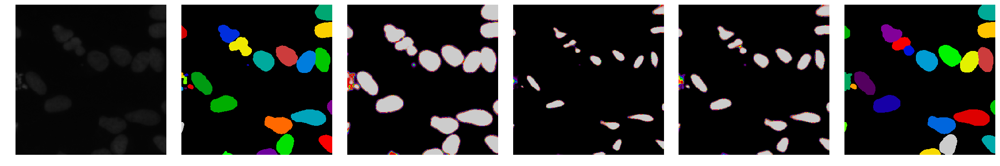

0.44859681946909713 0.590339913754


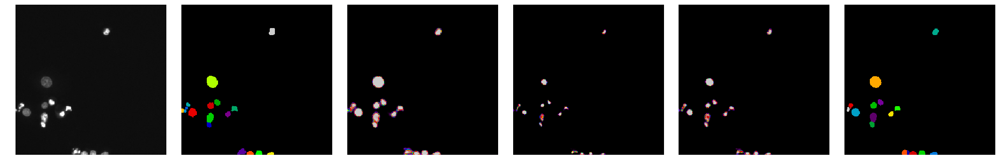

0.8256153374911415 0.596875342191


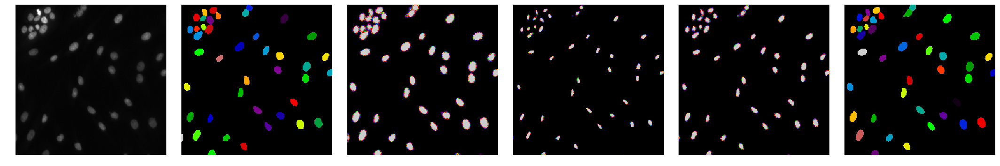

0.7929606625258799 0.602174945443


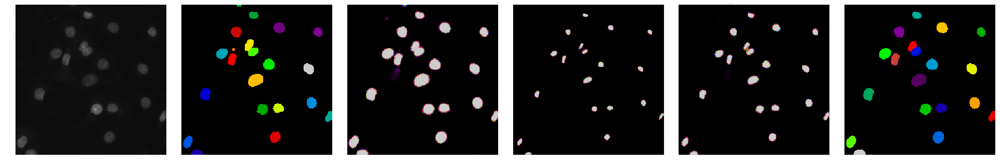

0.8781164965986396 0.60943656521


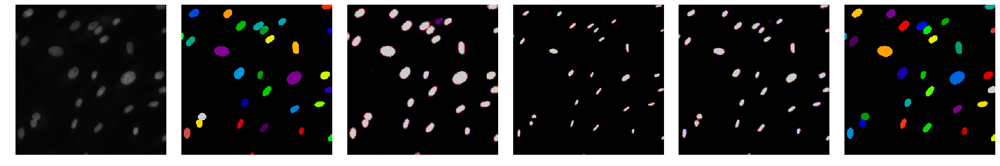

0.8385606069145879 0.615311540639


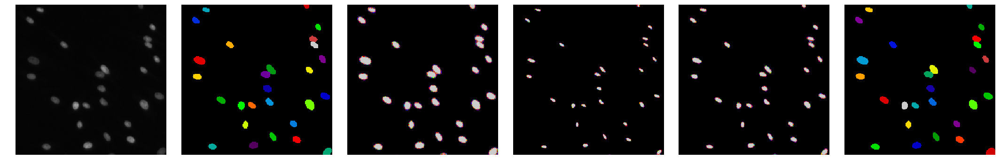

0.5319757075495645 0.613228144811


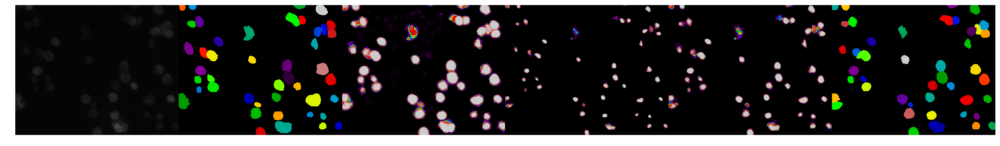

0.6556442904253732 0.614262684948


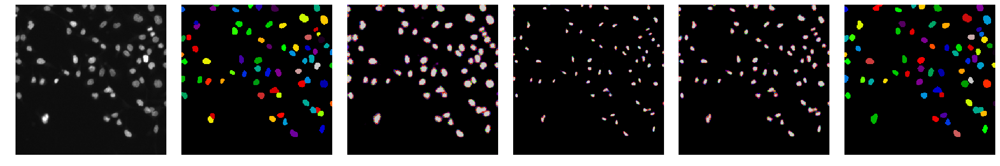

0.7847953216374269 0.618322985822


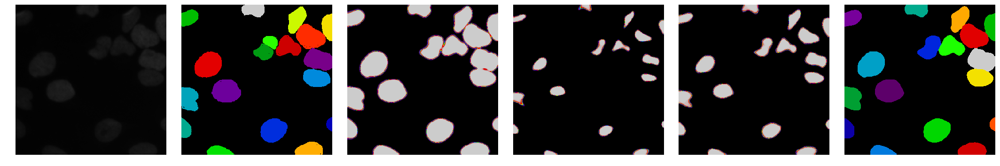

0.690051282051282 0.619991085734


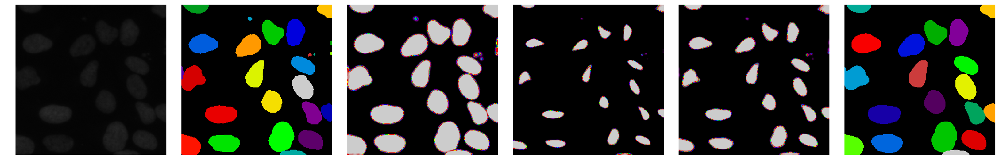

0.8888888888888887 0.626102399442


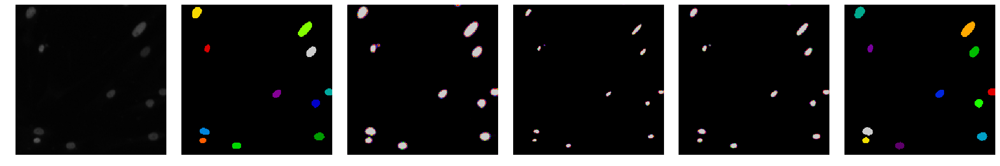

0.8878787878787879 0.631919652519


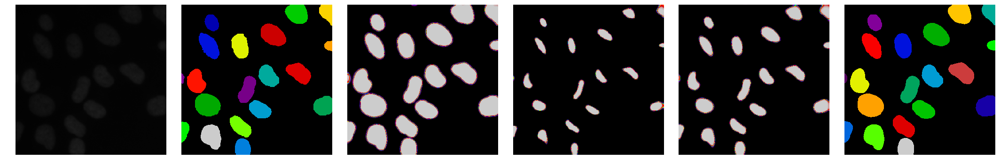

0.6745454545454547 0.632846300389


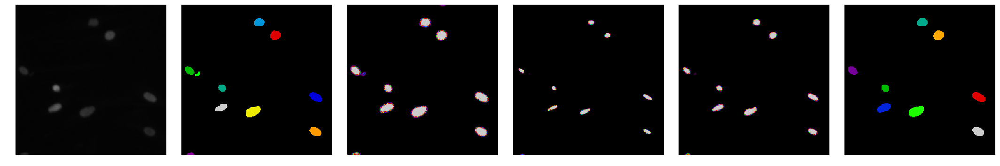

0.8955465587044534 0.638435667587


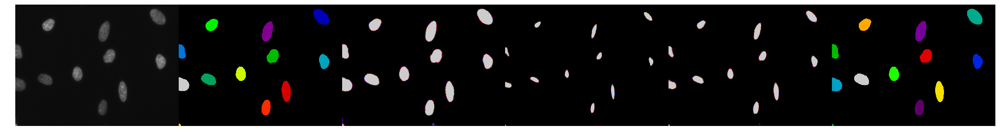

0.42434217723120876 0.633975386538


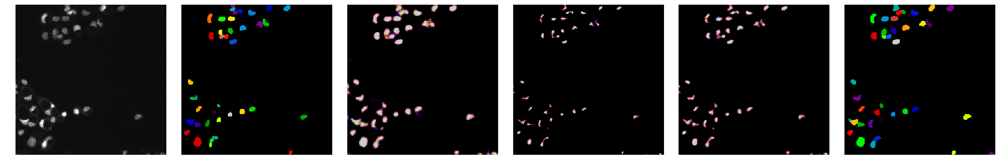

0.3638931413550372 0.628463503983


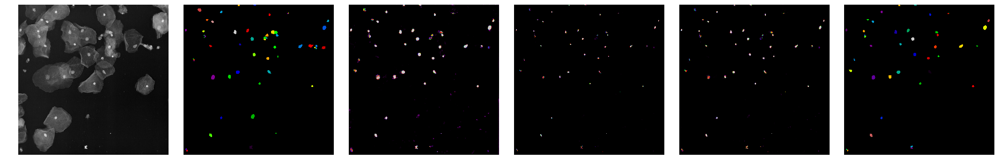

0.634510273008725 0.628584439364


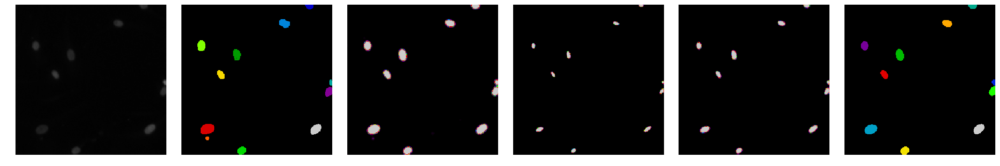

0.8238636363636364 0.632413443226


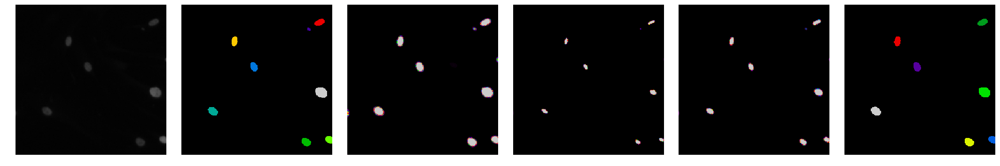

0.9208333333333334 0.637959979575


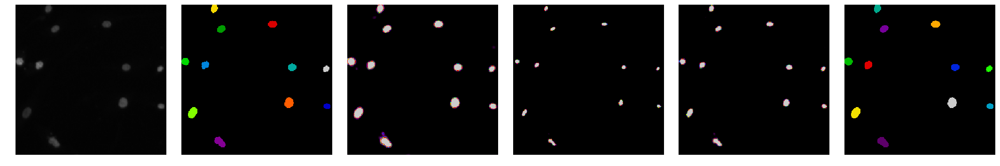

0.3775581764562274 0.633046738006


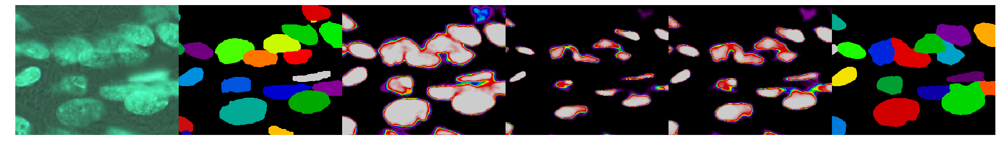

0.5258137939937547 0.631060942747


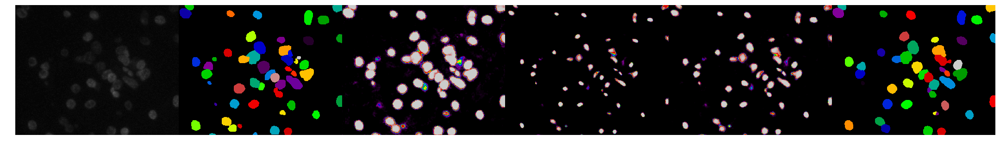

0.35976544846278785 0.626128297396


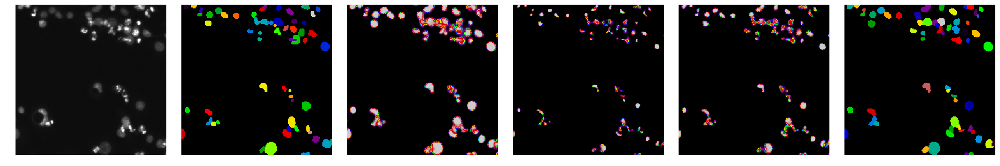

0.3714063814122587 0.621579691754


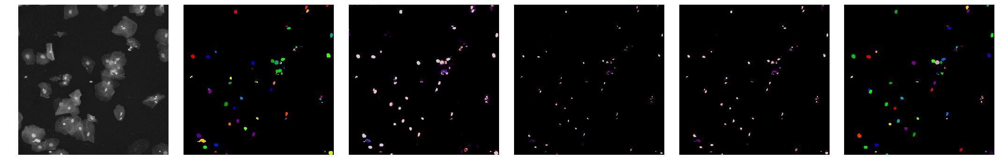

0.4232127278599959 0.61809956958


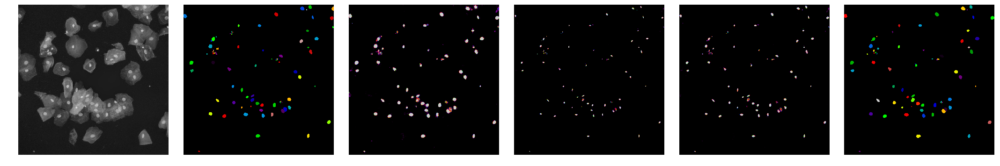

0.36436364982410474 0.613724812343


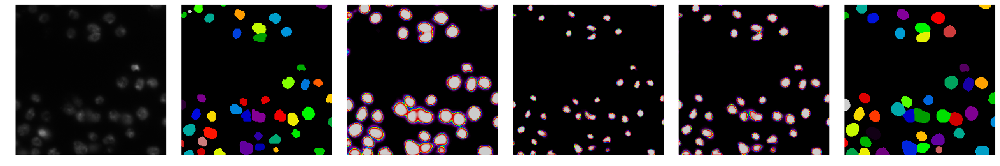

0.7290893902622121 0.615680144172


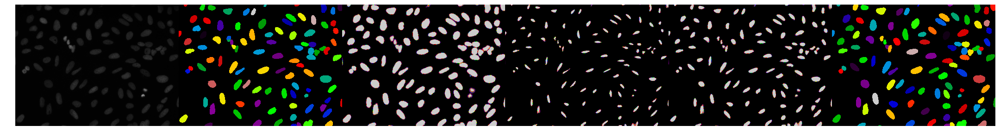

0.9208333333333334 0.620766030658


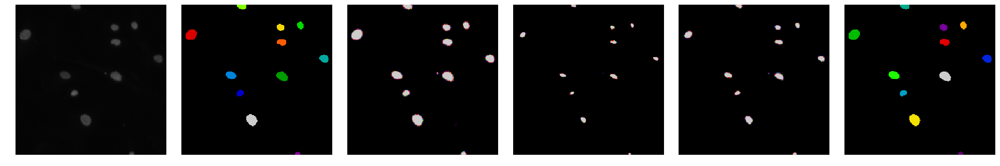

0.8136363636363637 0.623927839395


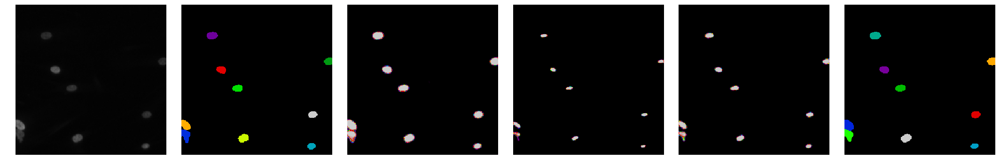

0.5063359706676706 0.622031196351


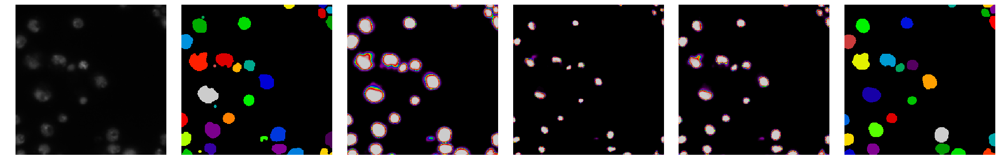

0.38525445079961973 0.618272835311


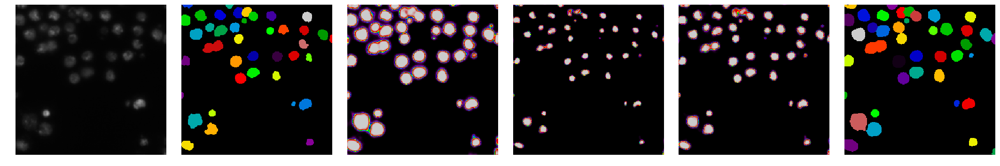

0.37153238240102643 0.614417515734


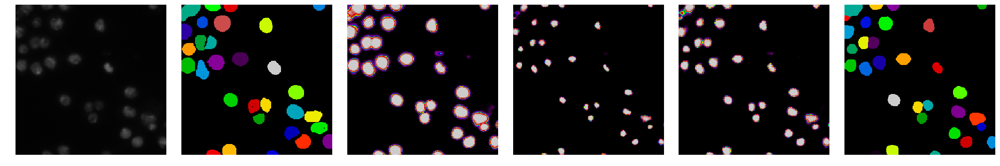

0.4744216383871557 0.612263733006


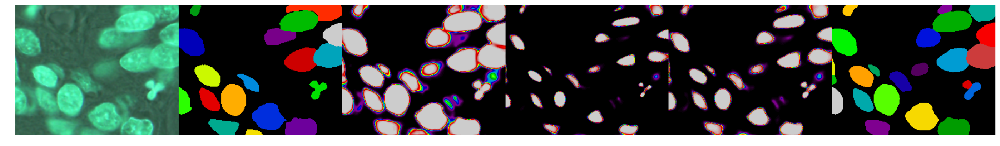

0.6645345713192837 0.613055715404


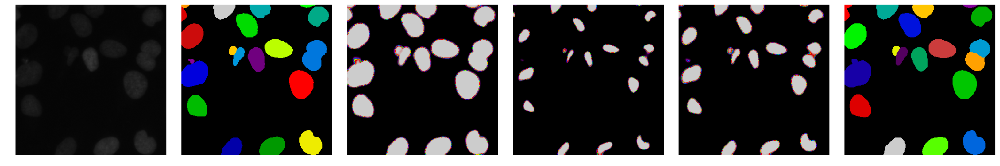

0.42442421713255263 0.610240319908


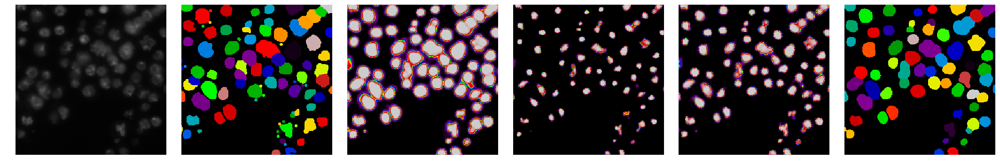

In [16]:
scores = []
for i, (img, pred) in enumerate(zip(val_images, val_predictions)):
    answer = watershed(pred,
        mask_threshold=0.5, center_threshold=0.7, width_holes=4, 
    width_objects=3, sigma=3, padding_size=5, min_size=16, footprint=np.ones((3, 3)))
    scores.append(local_mean_iou(get_labels(val_labels[i]), get_labels(answer)))
    print(scores[-1], np.mean(scores))
    draw.plots([img, val_labels[i], pred[..., 0], pred[..., 1], pred[..., 2], answer * 12367 % 1000], col_number=6)
    plt.show()

In [24]:
np.mean(scores)

0.61357941190382126

In [61]:
TEST_PATH = '../../stage1_test/'

test_ids, _ = io.read_test_data(TEST_PATH, d=3)

Reading test data..: 100%|██████████| 65/65 [00:00<00:00, 272.86it/s]


In [63]:
test_transform = transforms.DualCompose(
    [
        transforms.ImageOnly(transforms.Normalize(
            mean=[0.485, 0.456, 0.406],
            std=[0.229, 0.224, 0.225]))
    ]
)

test_predictions, test_names = predict.predict(model, test_ids, "../../data/test/{}.png", test_transform, 1, 2)

Predict: 100%|██████████| 65/65 [00:08<00:00,  7.63it/s]


In [64]:
test_images = []
for _id in tqdm(test_names):
    test_images.append(cv2.imread("../../data/test/{}.png".format(_id)))

100%|██████████| 65/65 [00:00<00:00, 332.40it/s]


0


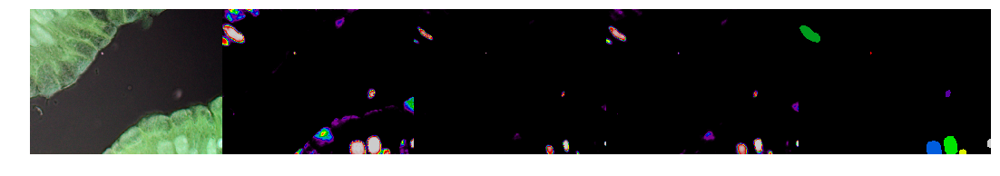

1


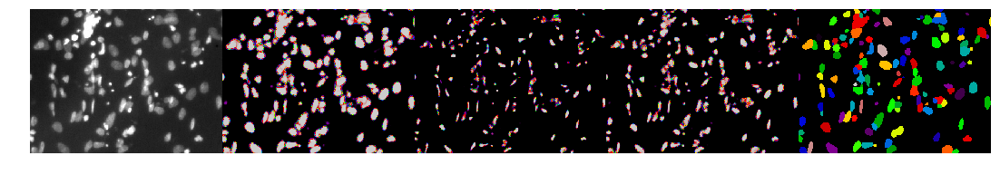

2


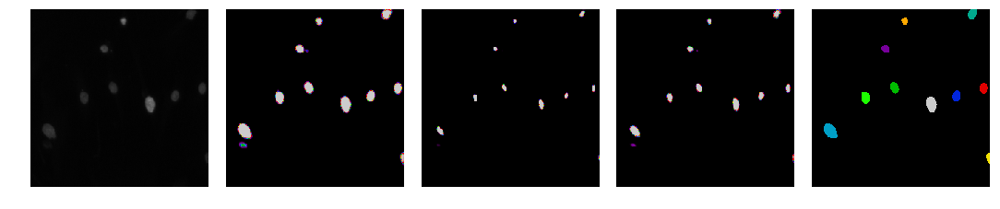

3


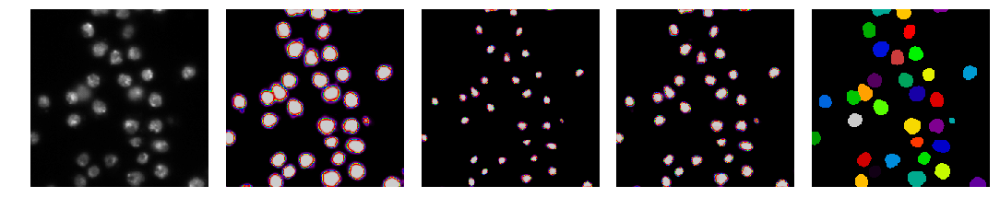

4


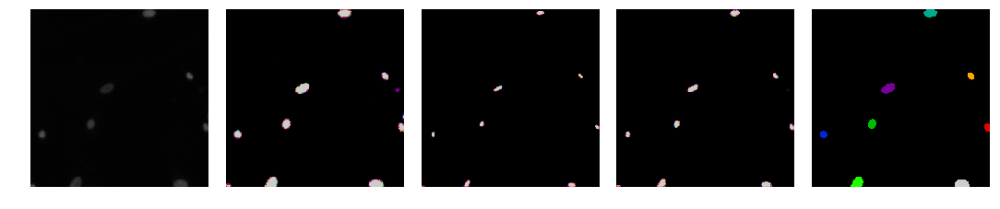

5


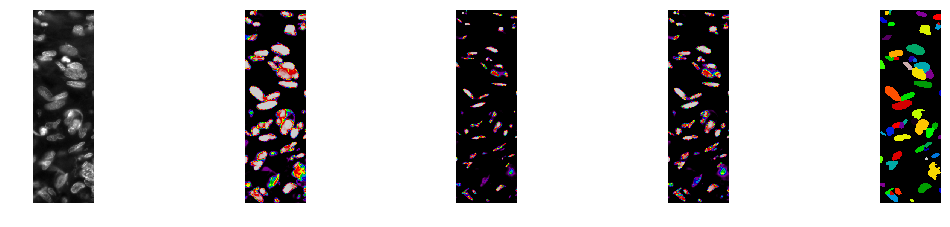

6


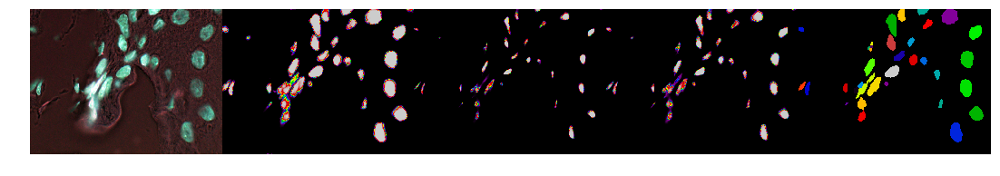

7


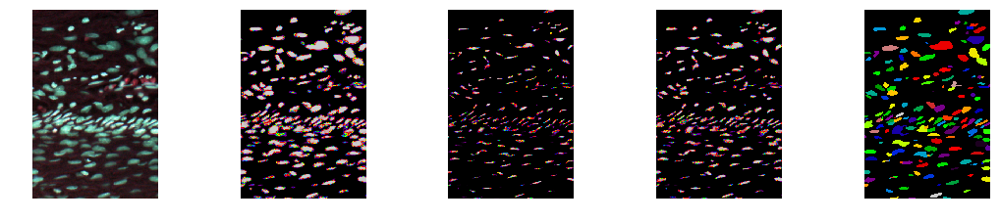

8


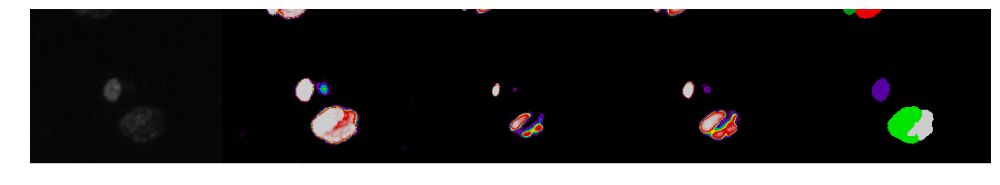

9


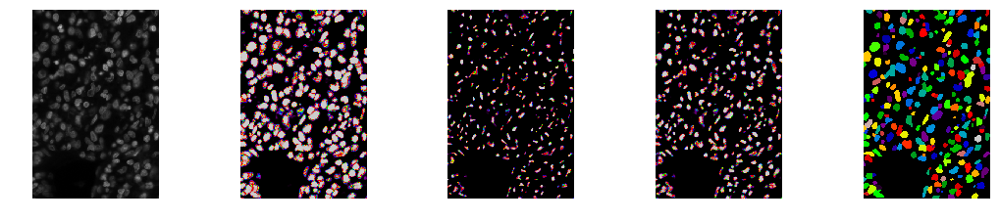

10


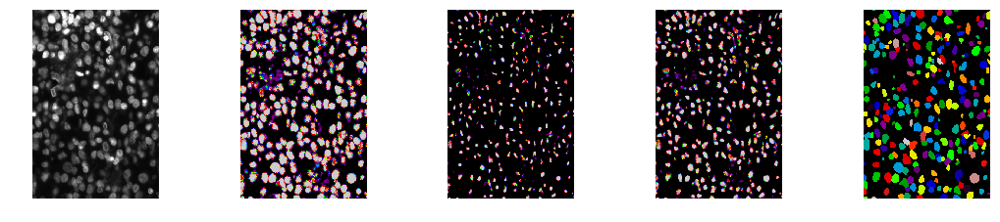

11


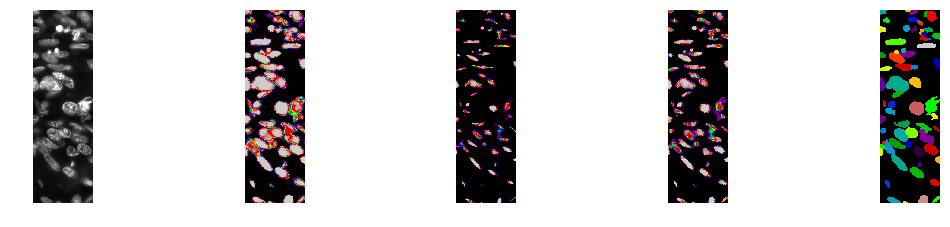

12


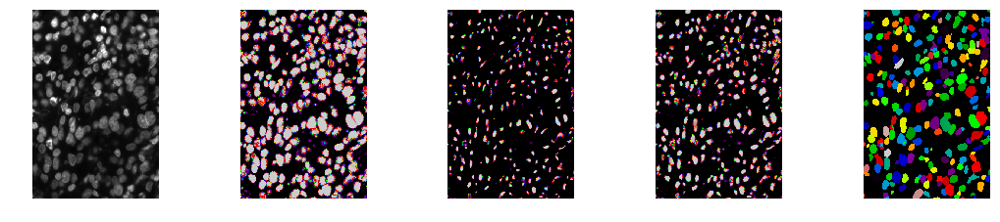

13


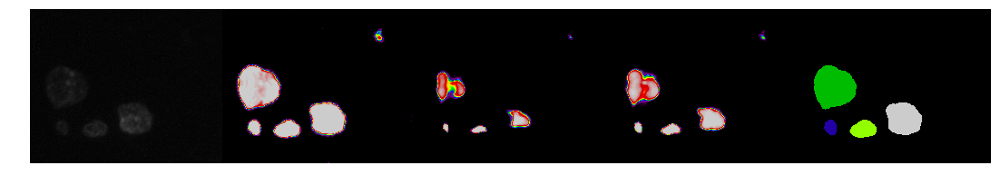

14


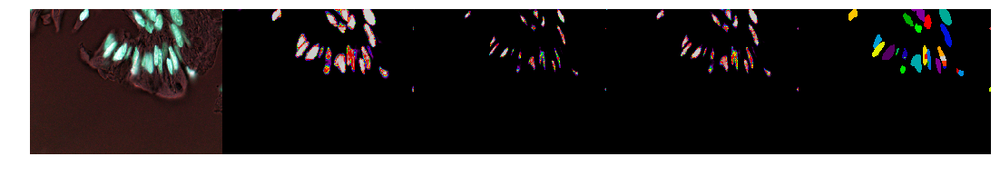

15


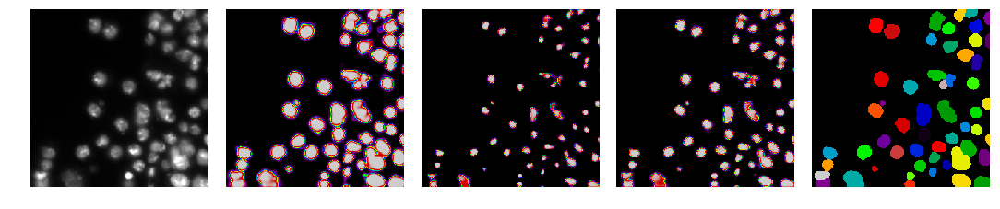

16


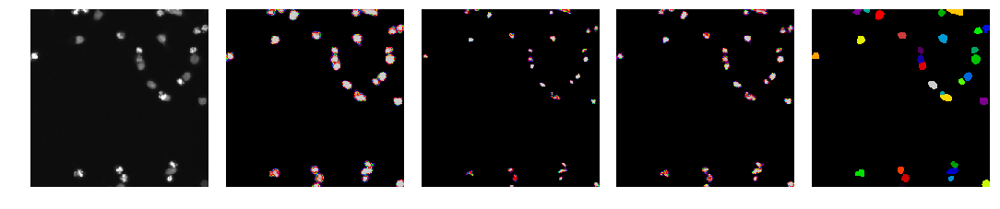

17


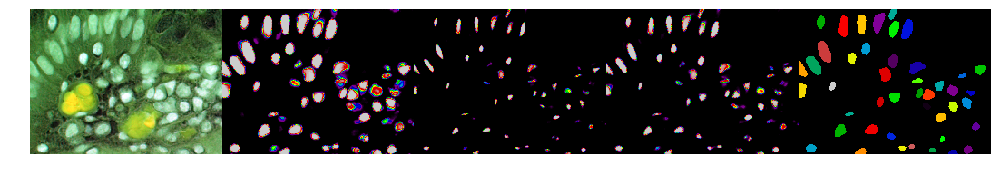

18


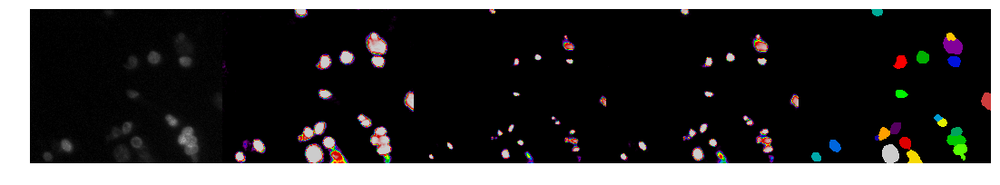

19


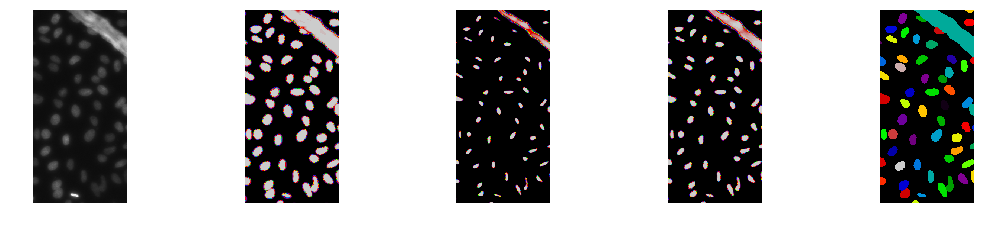

20


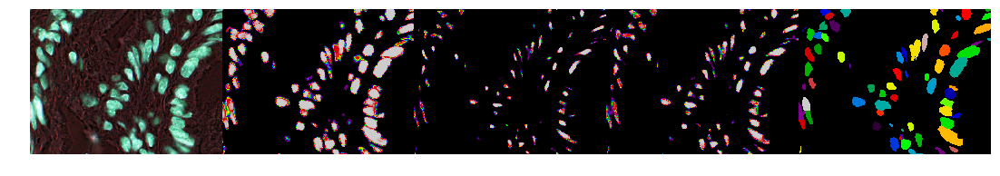

21


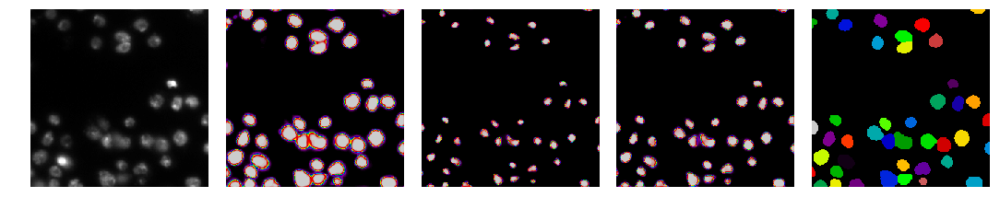

22


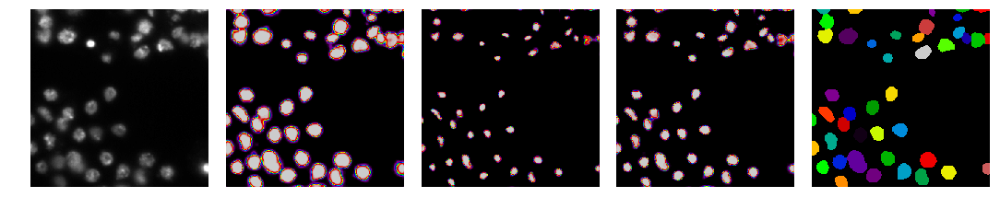

23


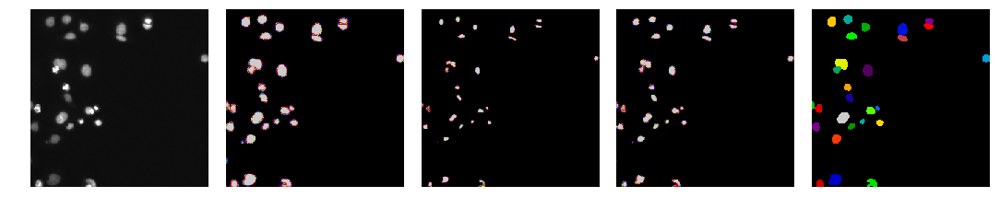

24


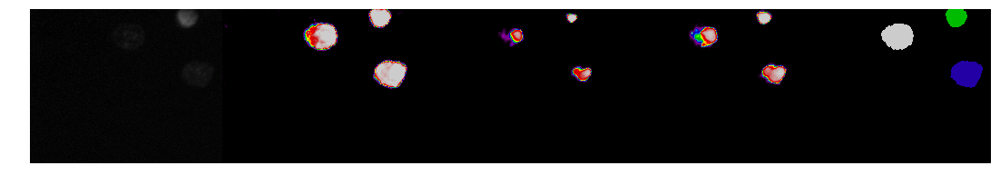

25


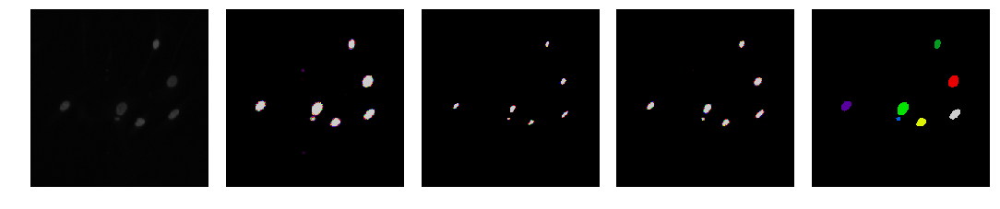

26


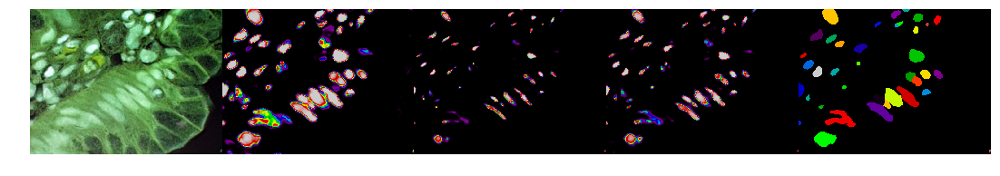

27


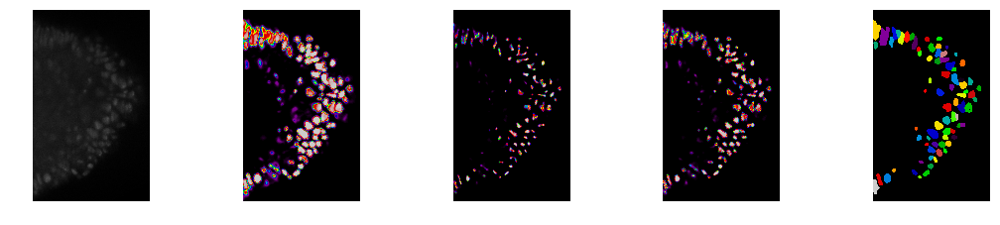

28


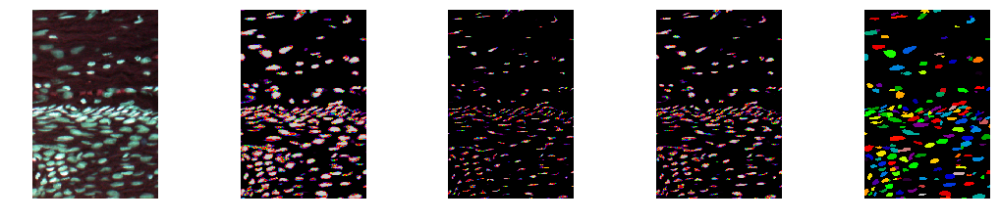

29


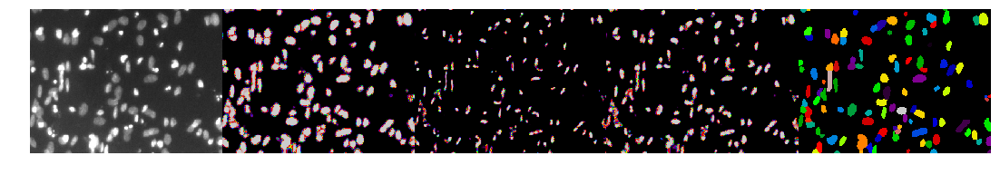

30


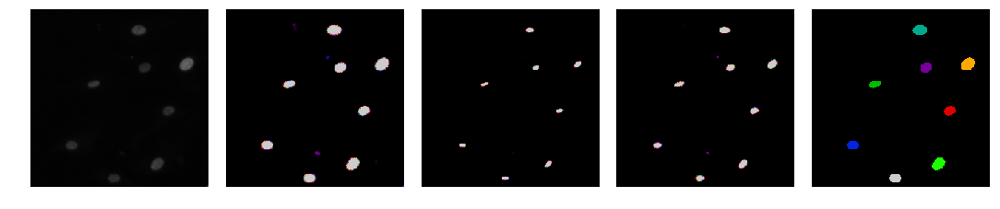

31


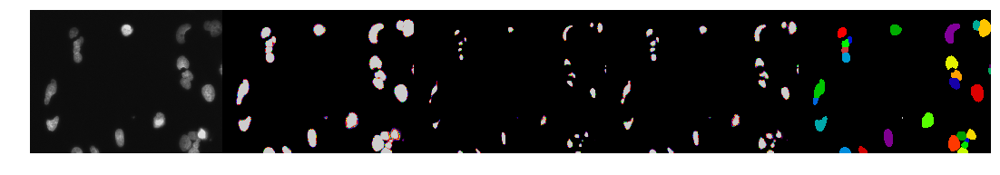

32


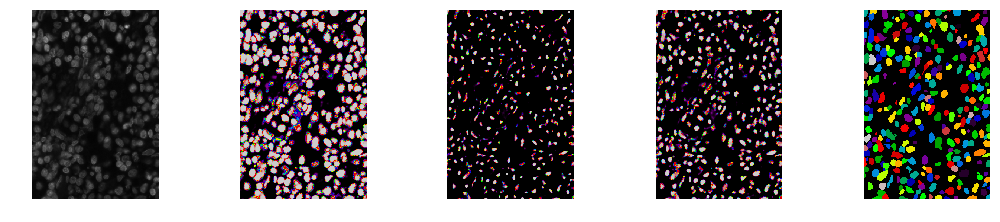

33


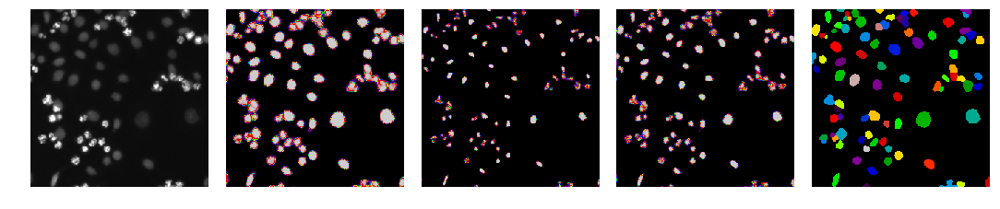

34


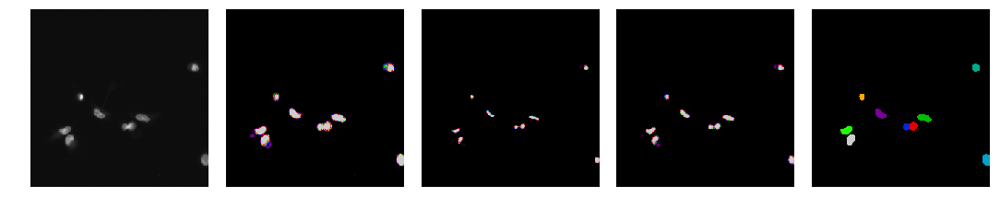

35


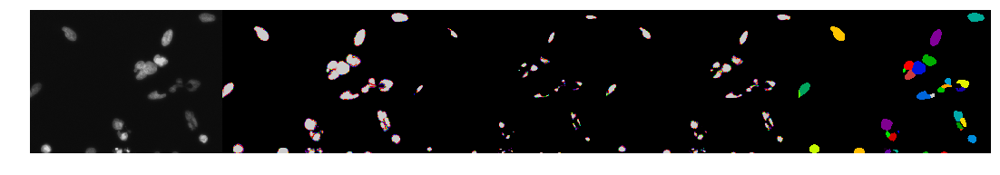

36


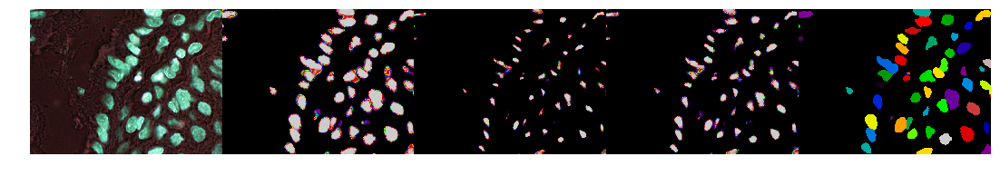

37


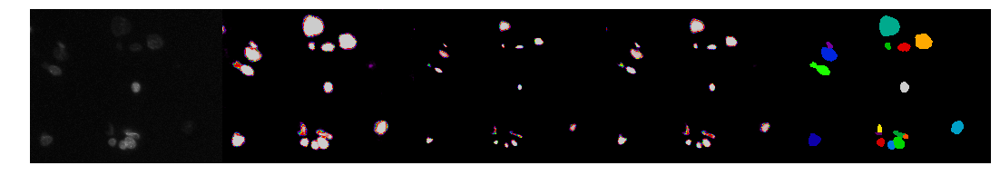

38


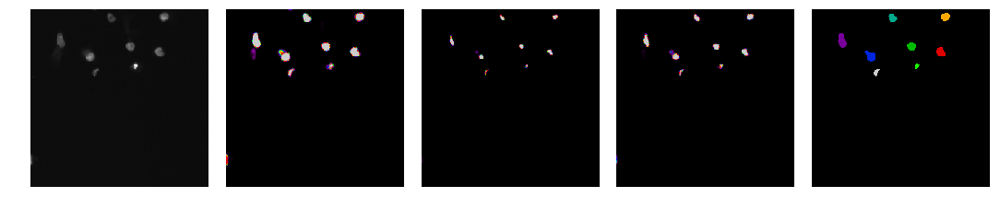

39


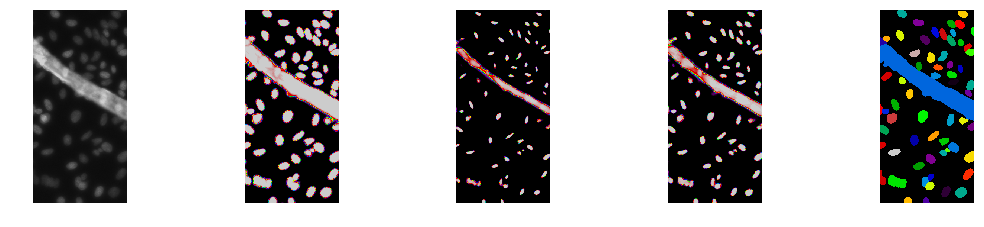

40


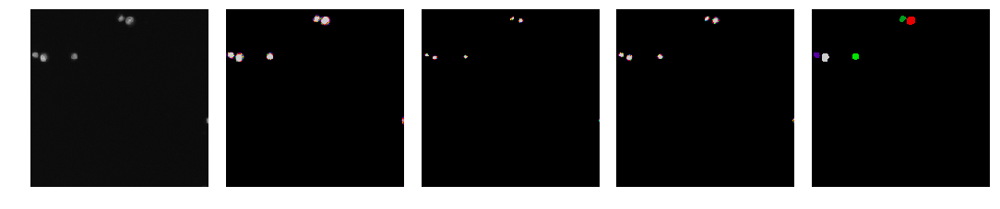

41


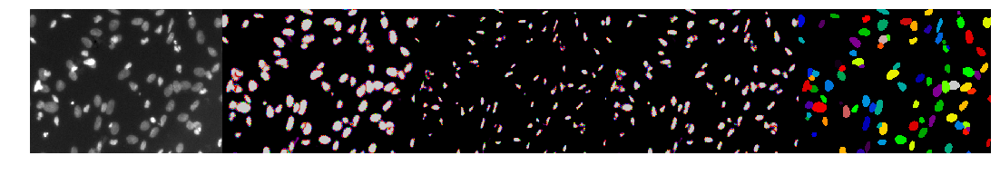

42


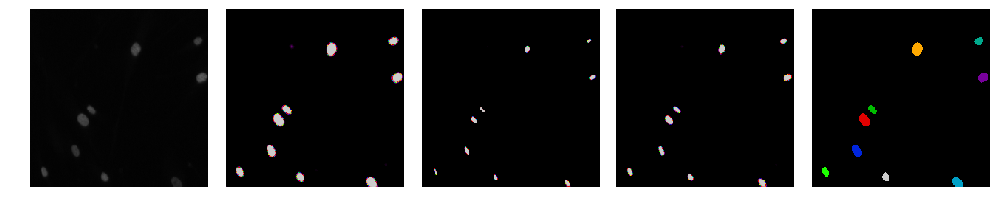

43


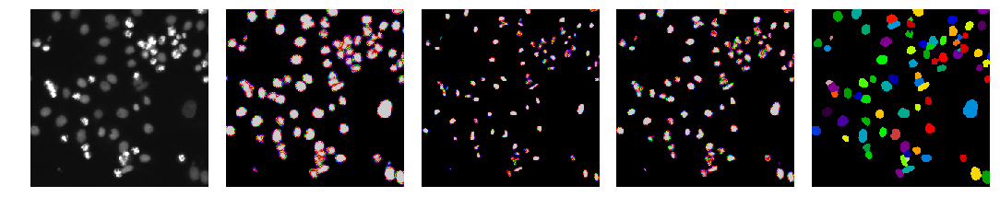

44


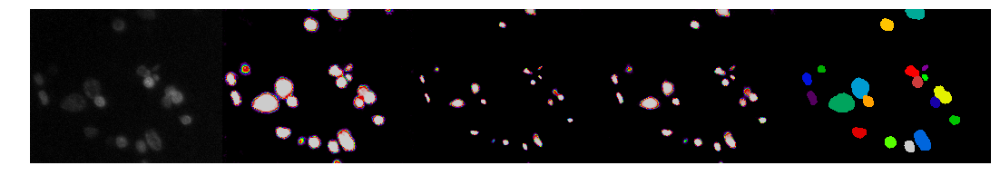

45


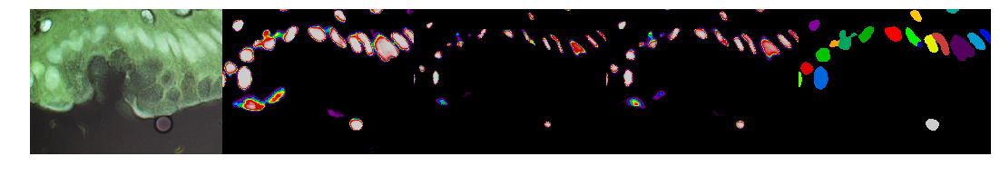

46


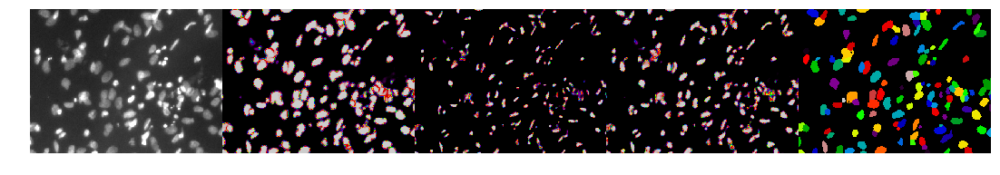

47


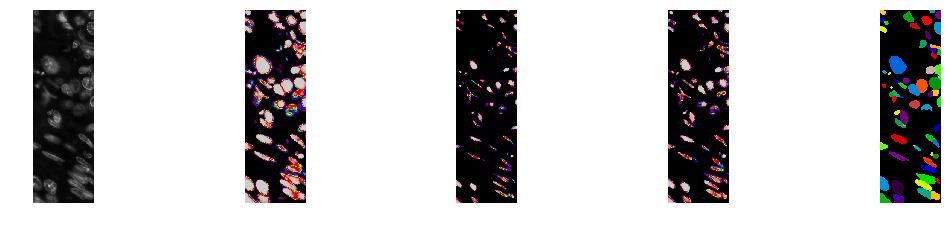

48


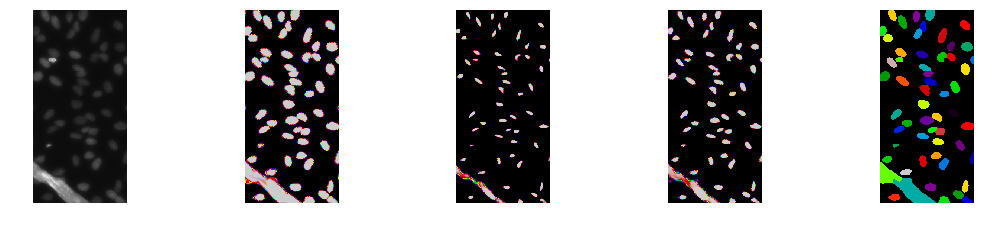

49


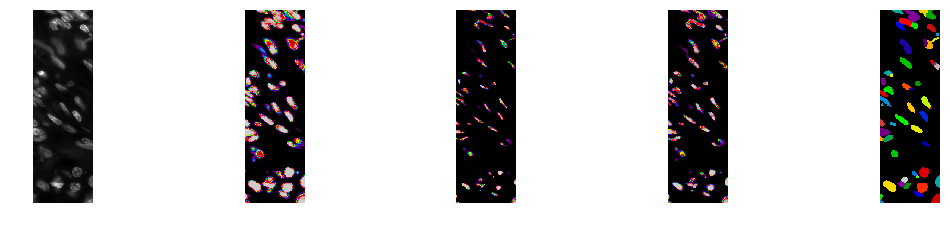

50


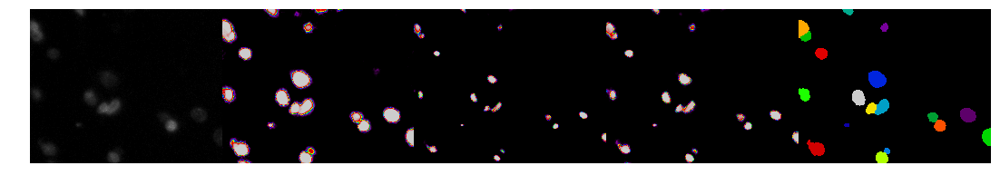

51


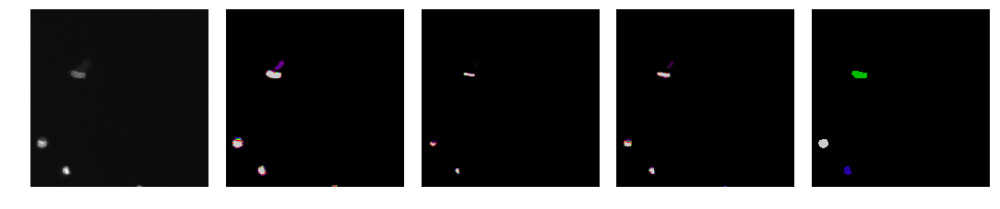

52


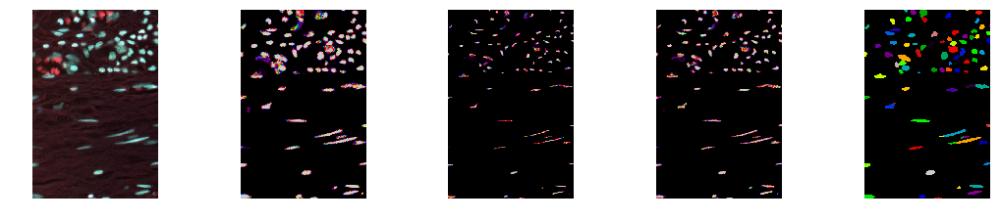

53


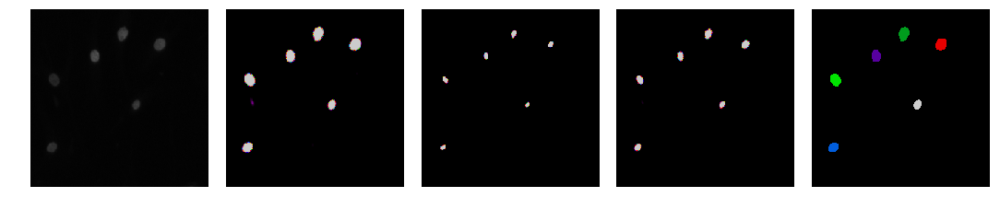

54


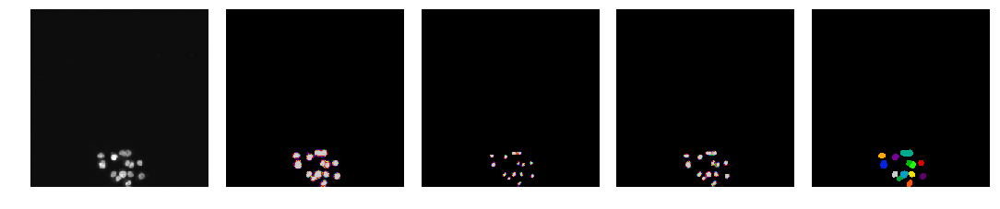

55


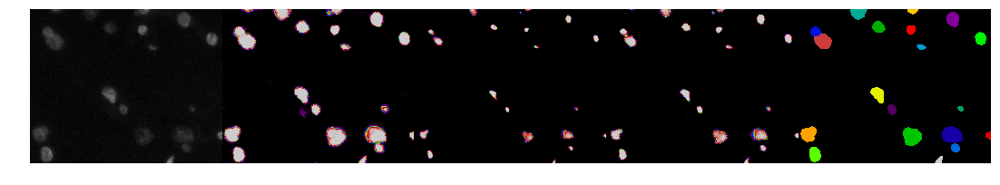

56


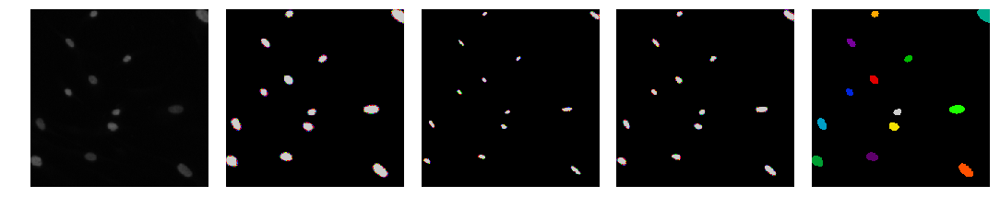

57


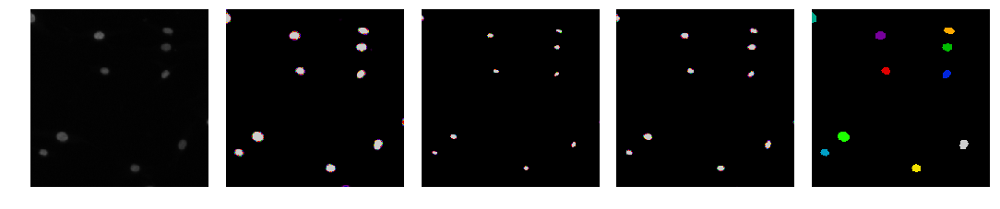

58


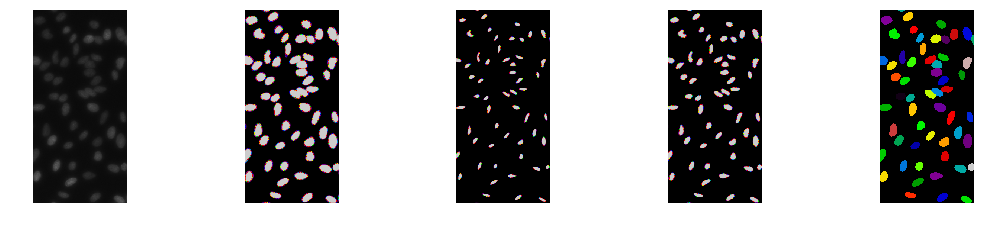

59


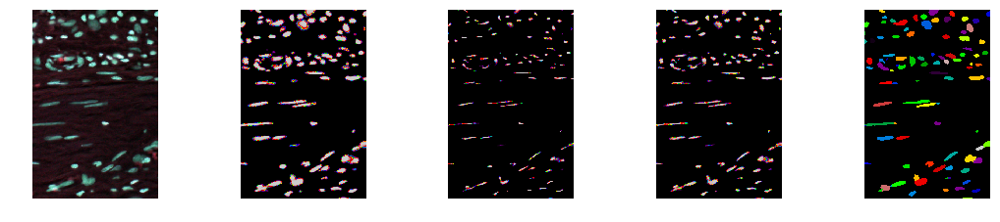

60


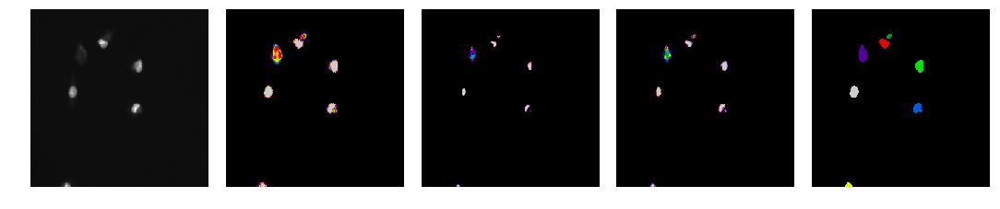

61


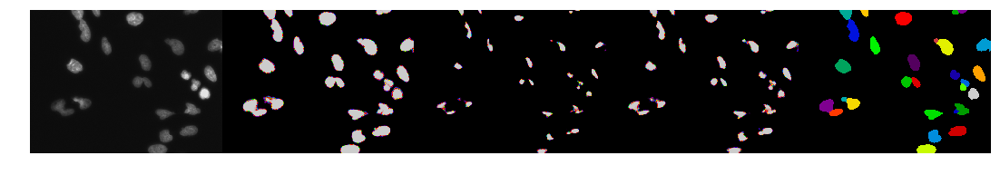

62


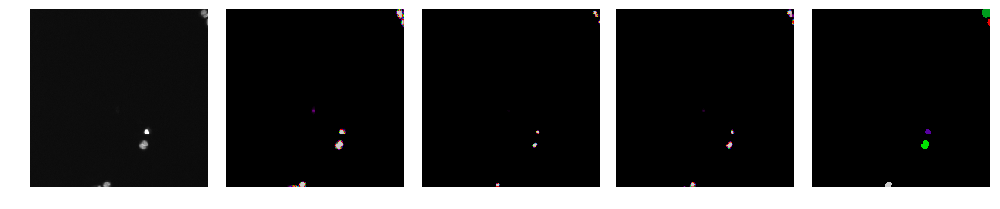

63


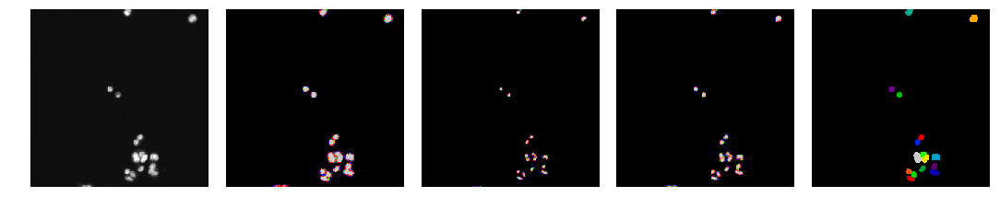

64


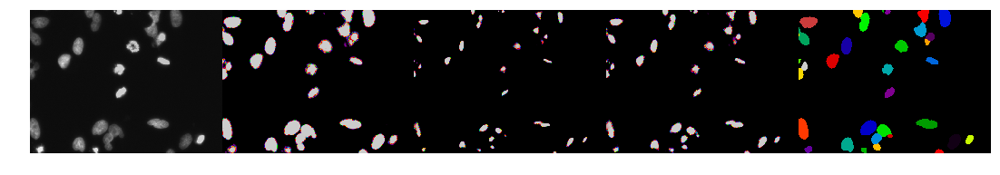

In [65]:
for i in range(len(test_images)):
    print(i)
    draw.plots([
      test_images[i],
      test_predictions[i][..., 0],
        test_predictions[i][..., 1],
        test_predictions[i][..., 2],
      watershed(
        test_predictions[i], mask_threshold=0.5, center_threshold=0.7, width_holes=4, 
    width_objects=3, sigma=3, padding_size=5, min_size=16, footprint=np.ones((3, 3))
    ) * 12367 % 1000,
    ], scale=3, col_number=5)
    plt.show()

0


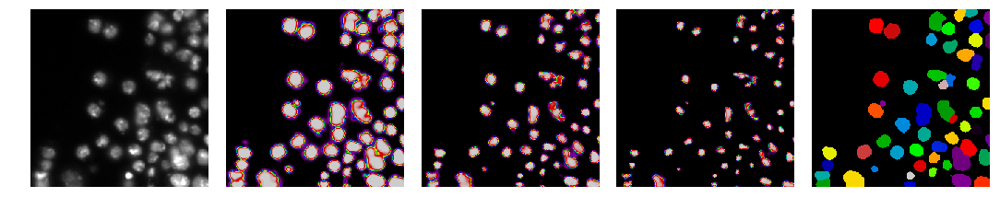

1


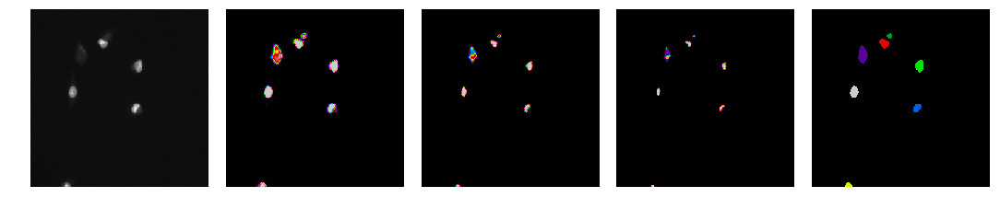

2


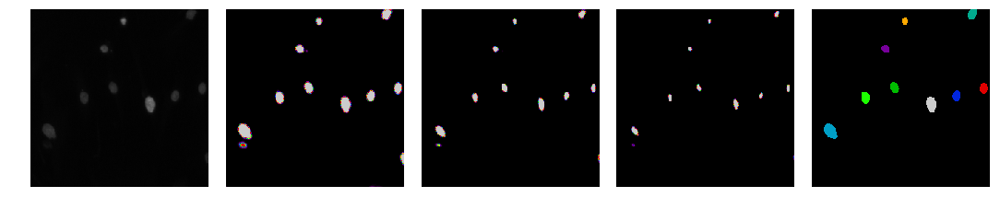

3


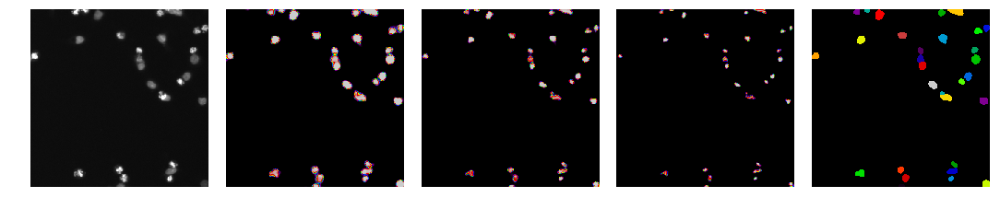

4


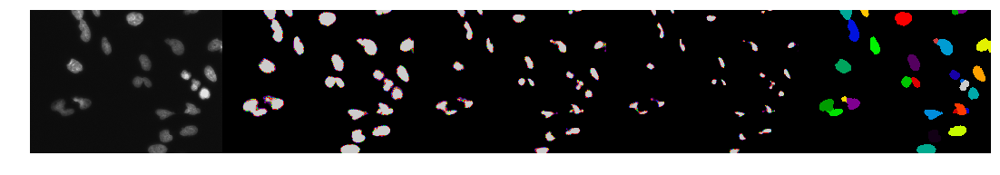

5


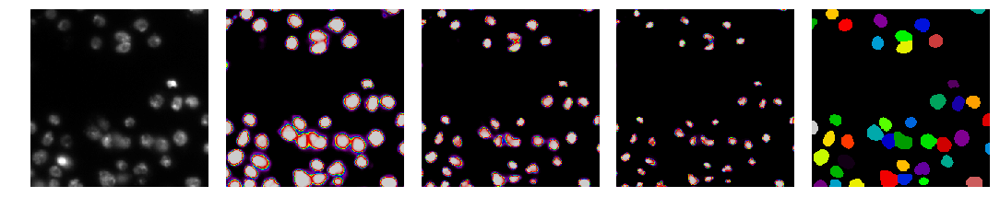

6


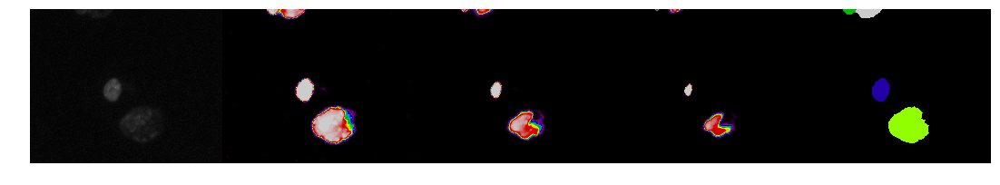

7


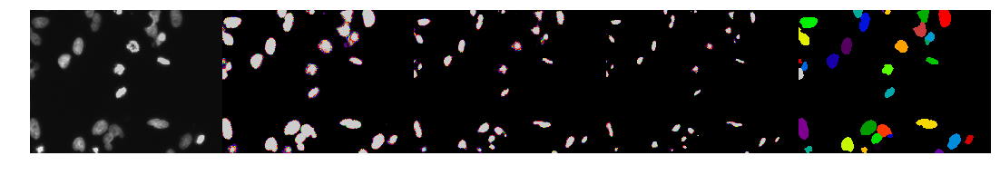

8


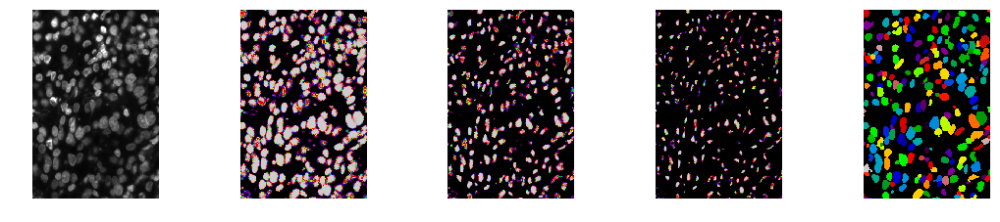

9


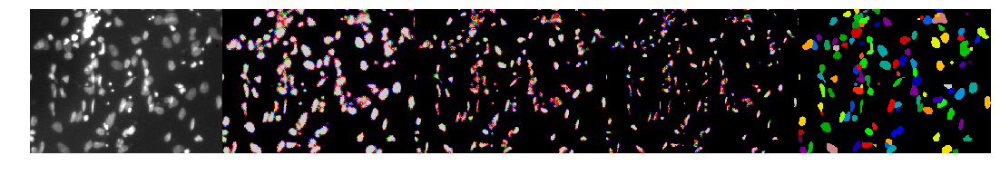

10


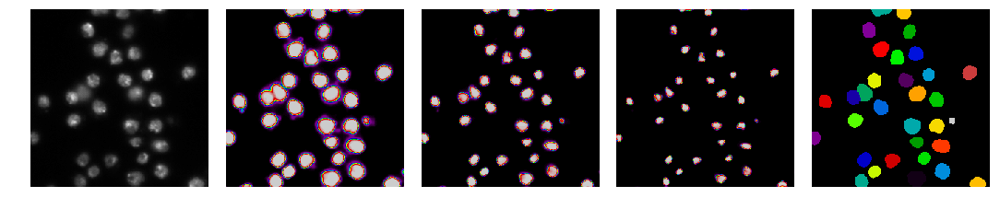

11


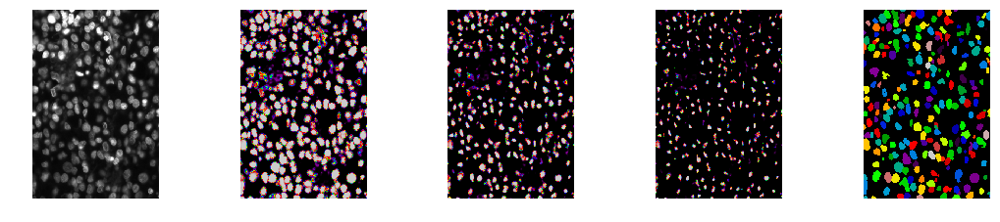

12


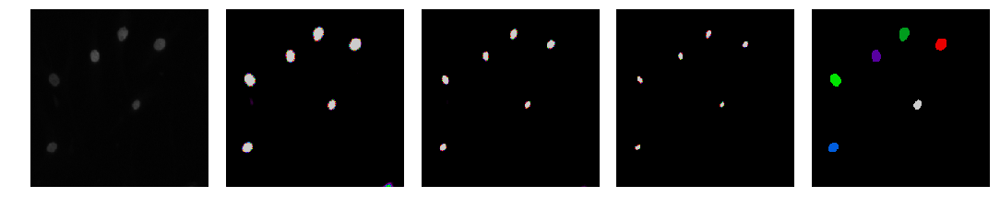

13


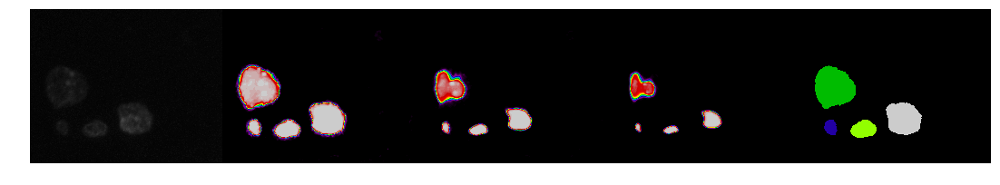

14


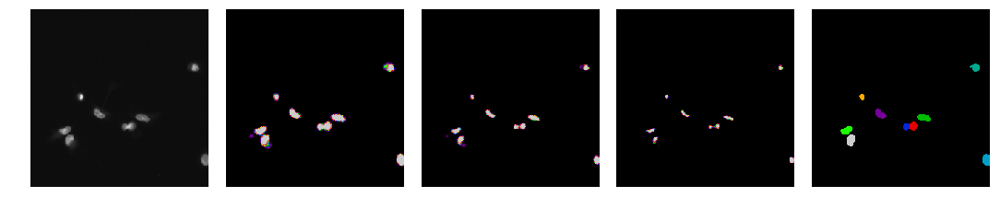

15


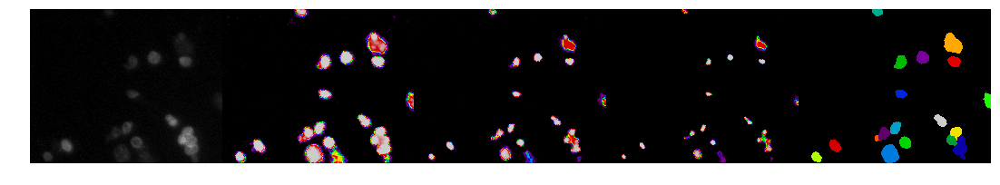

16


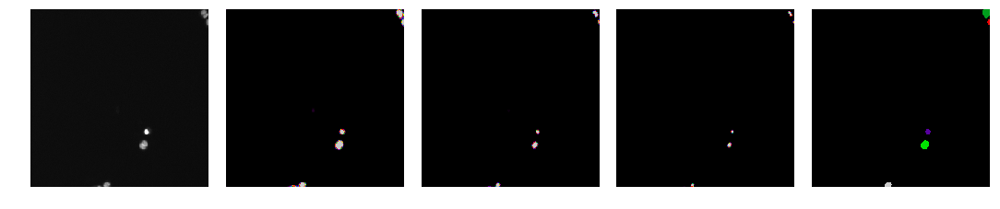

17


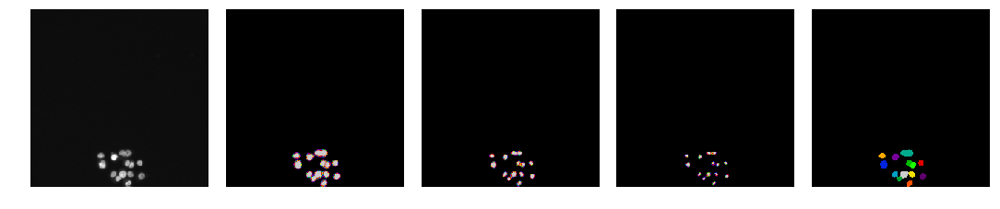

18


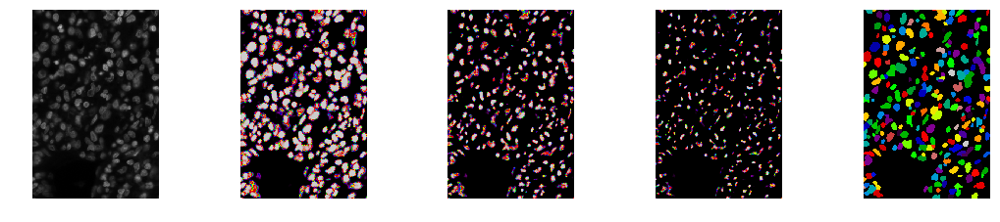

19


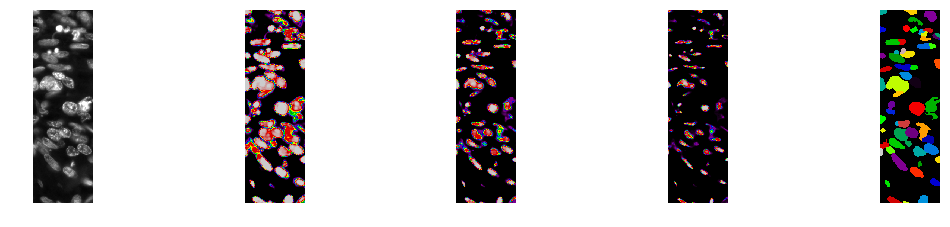

20


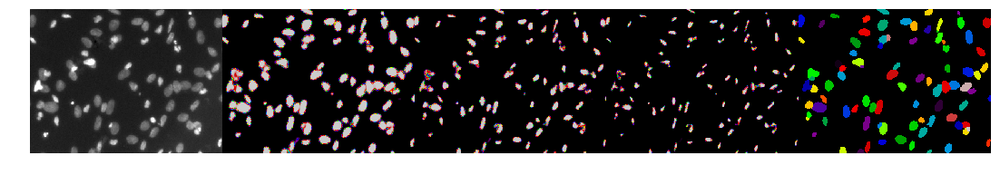

21


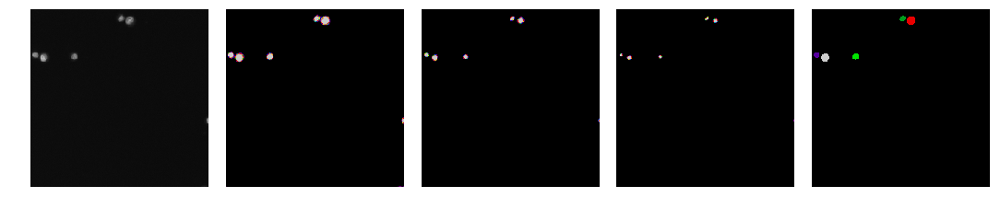

22


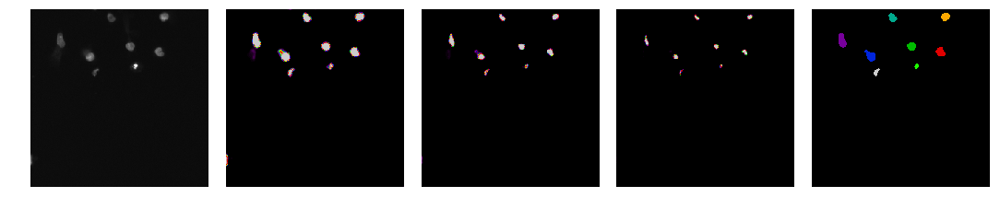

23


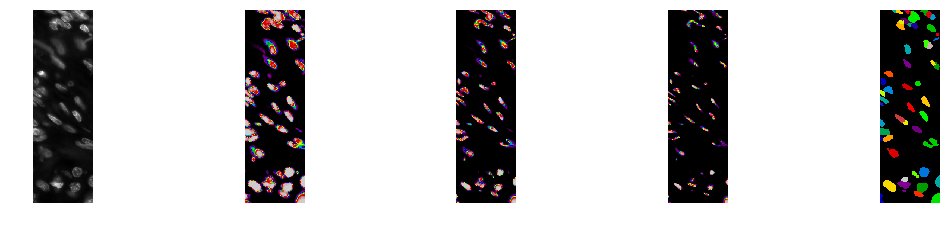

24


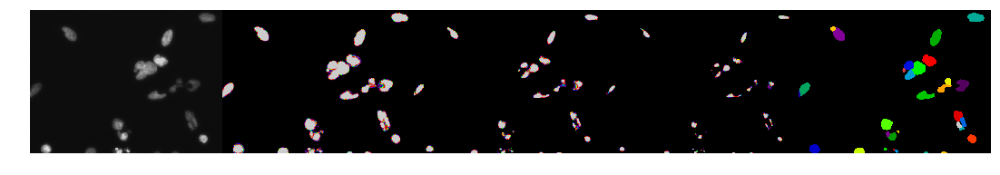

25


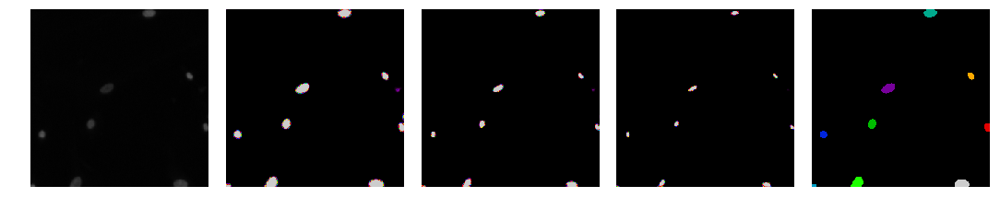

26


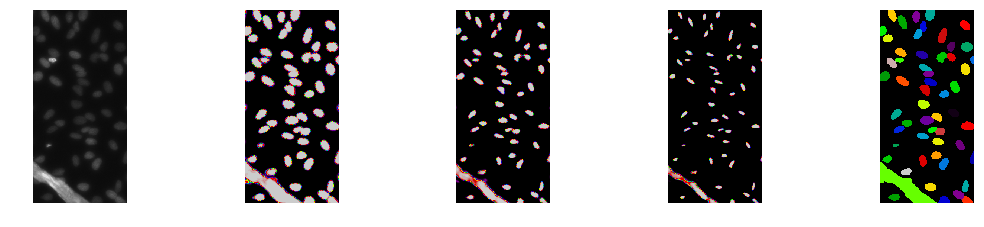

27


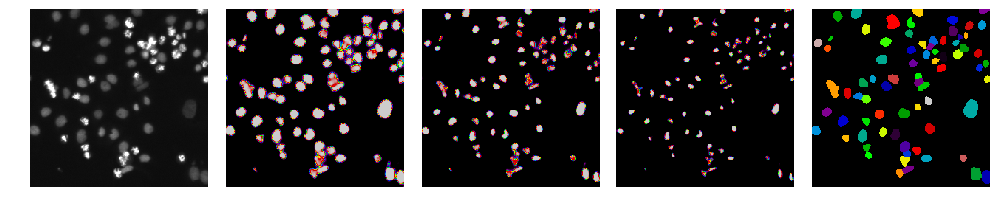

28


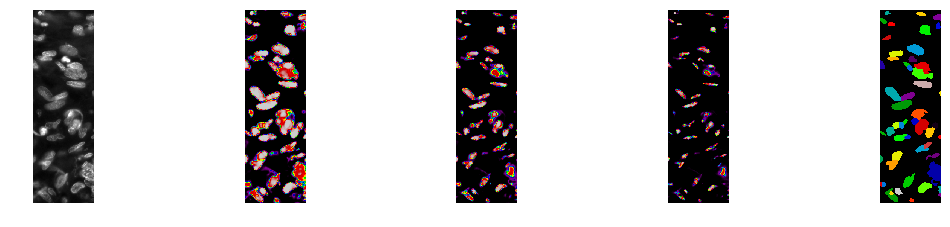

29


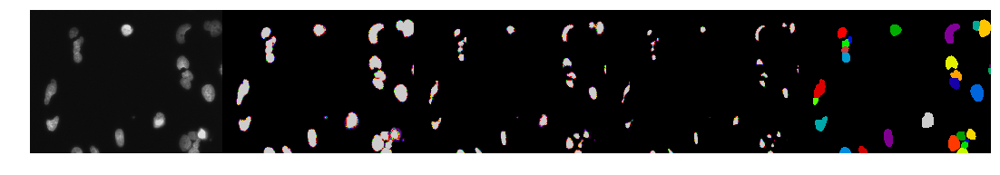

30


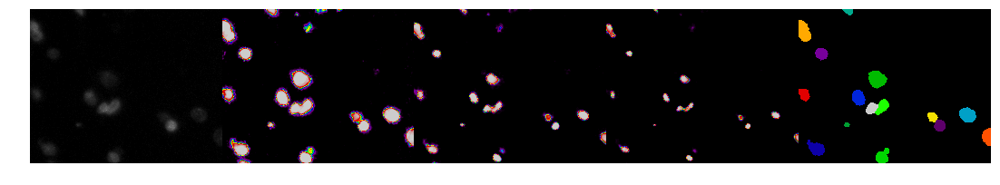

31


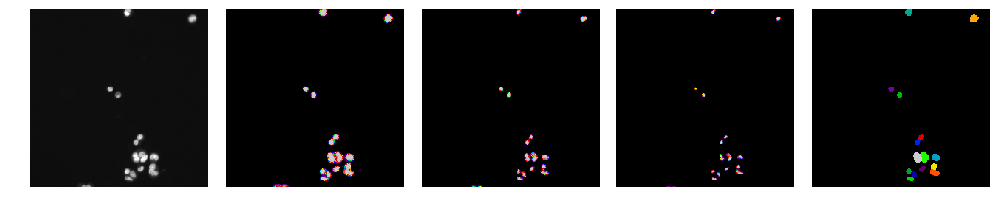

32


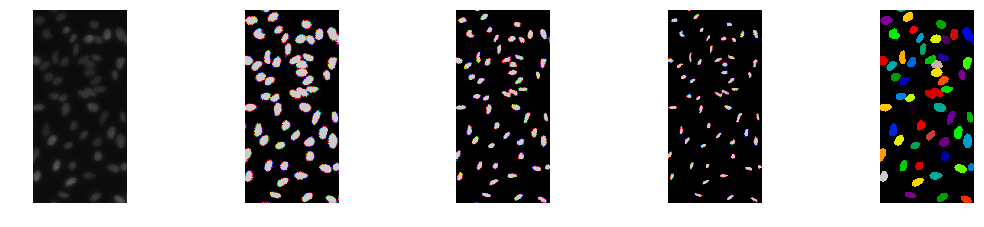

33


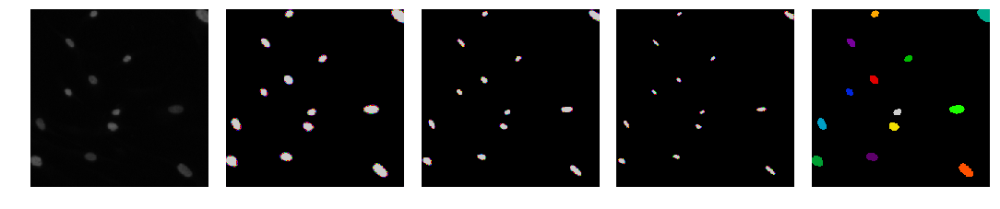

34


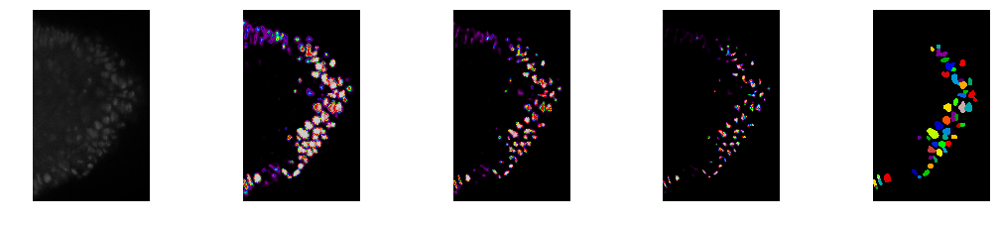

35


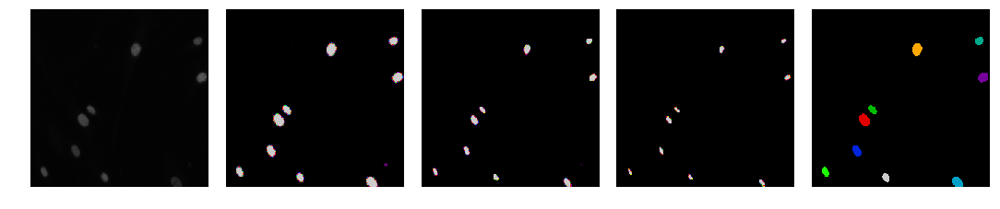

36


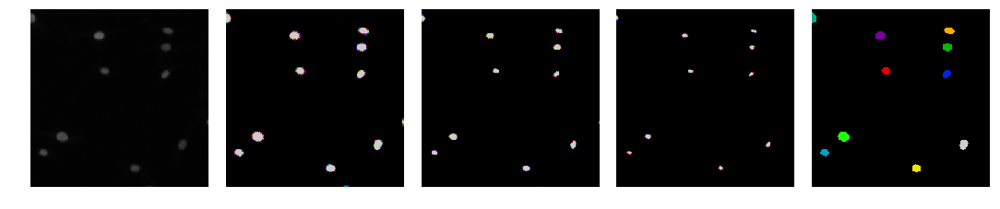

37


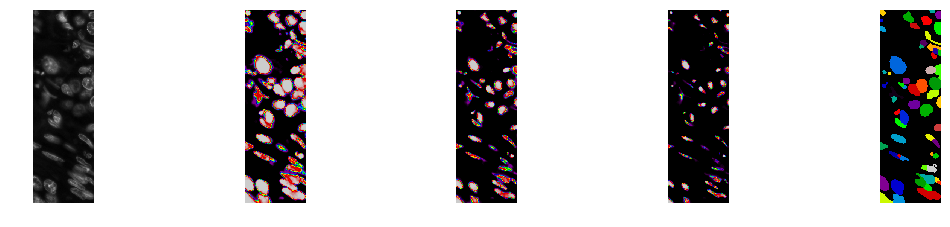

38


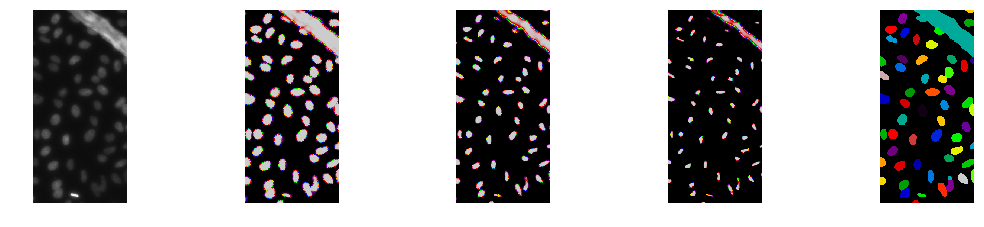

39


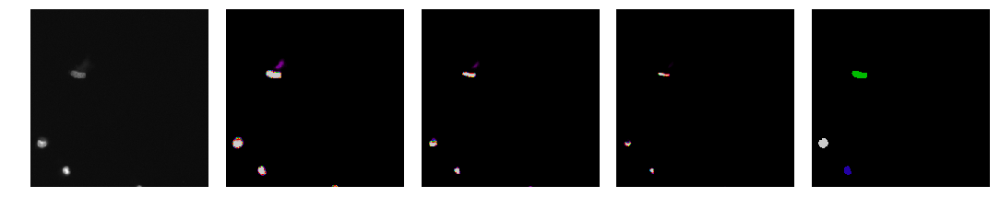

40


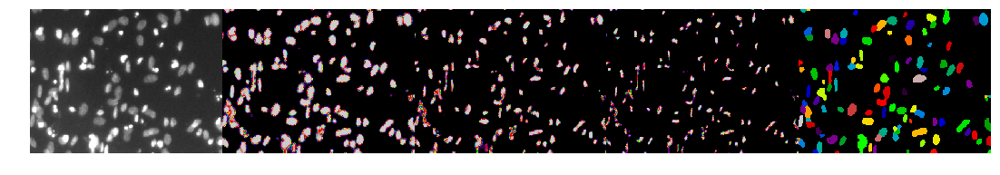

41


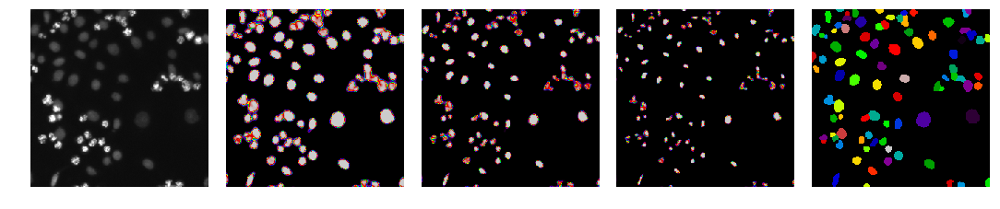

42


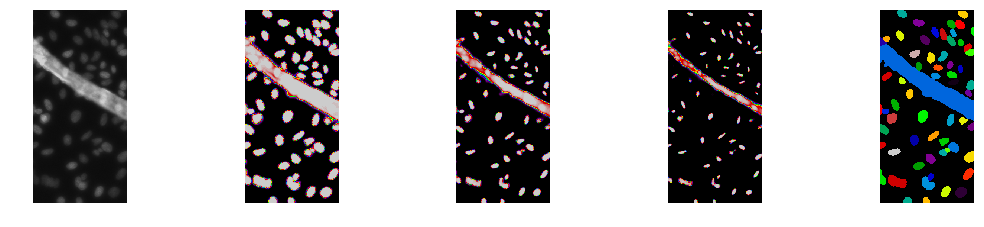

43


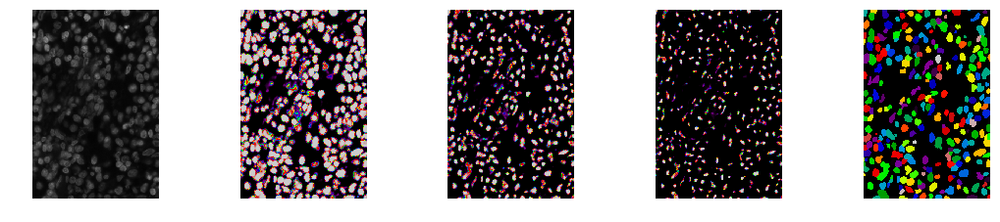

44


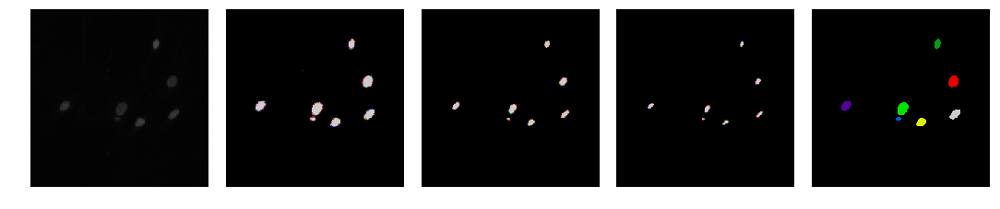

45


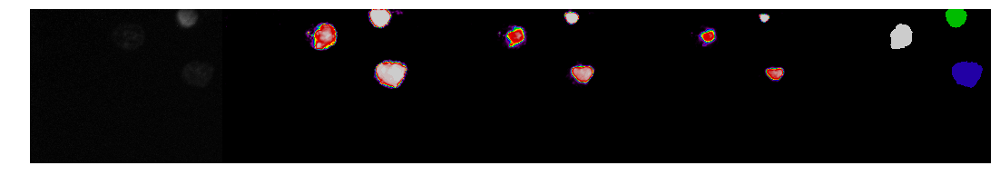

46


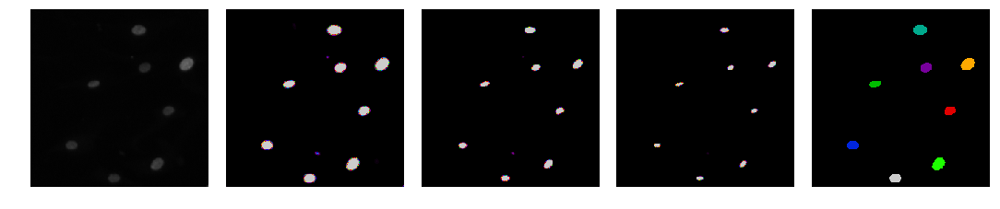

47


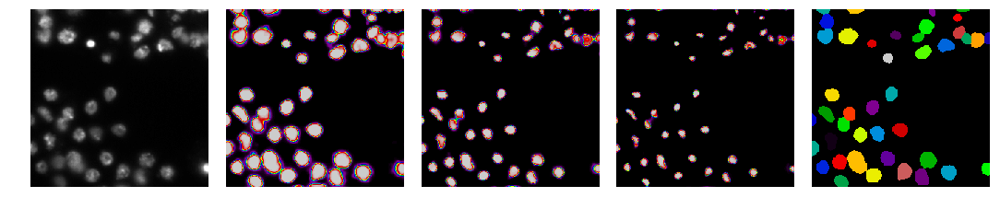

48


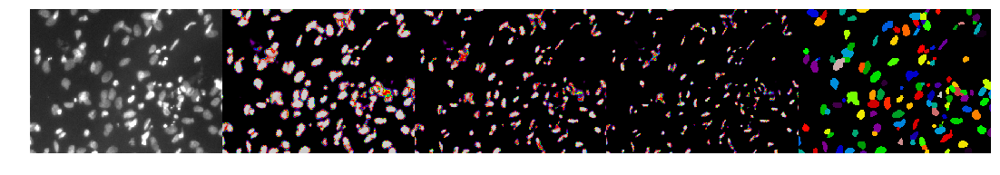

49


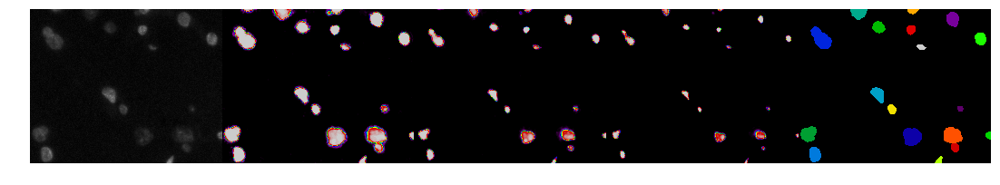

50


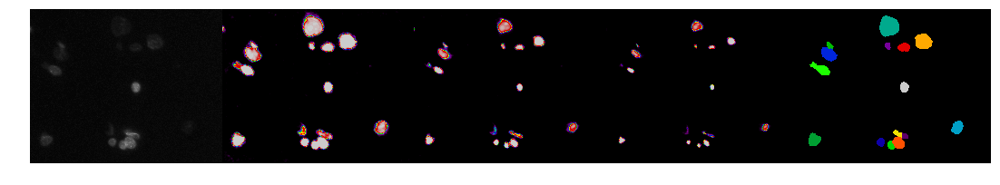

51


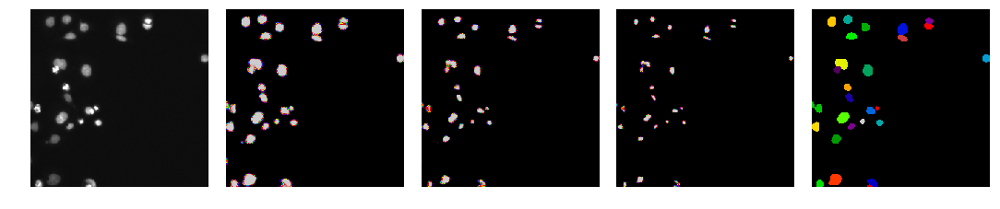

52


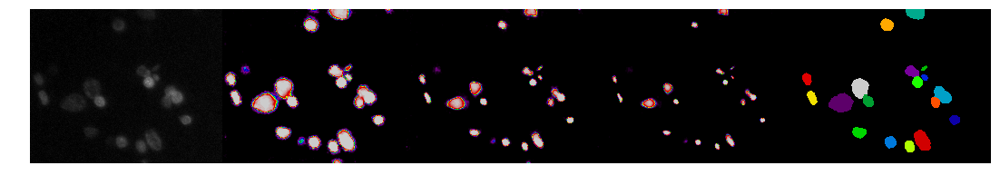

53


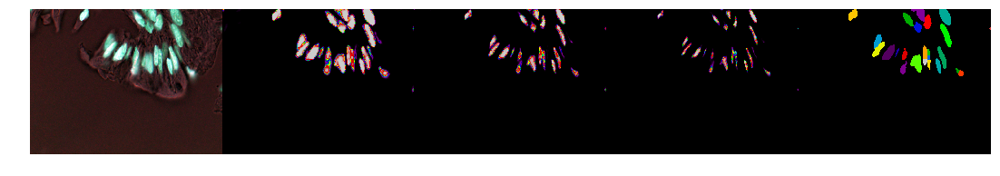

54


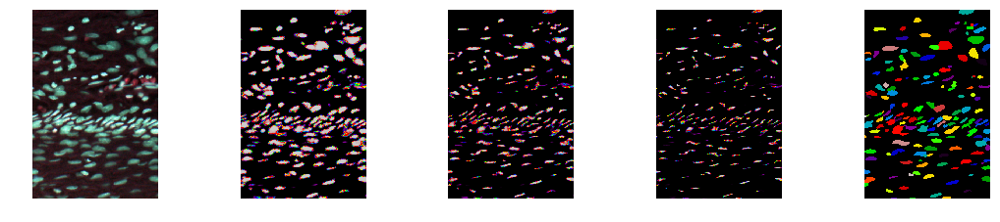

55


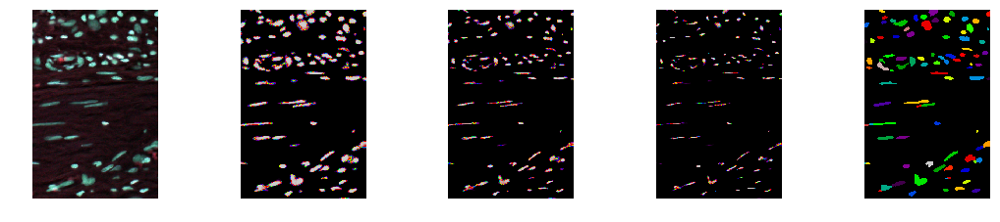

56


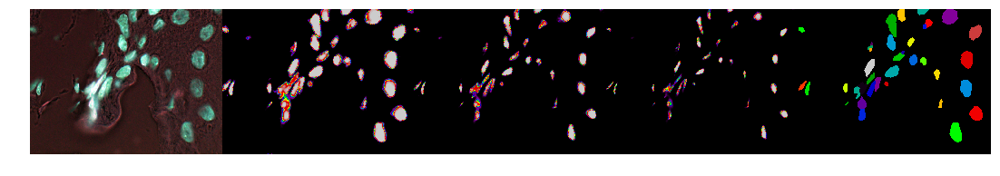

57


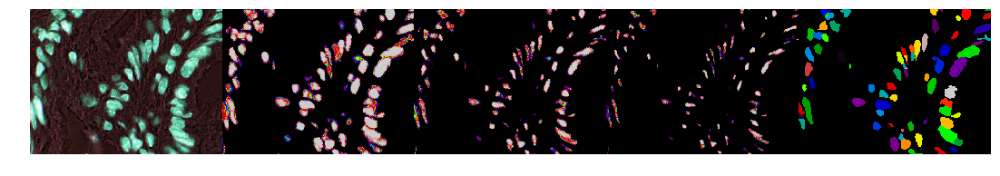

58


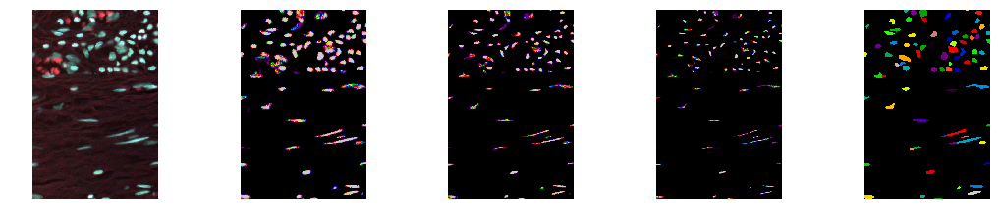

59


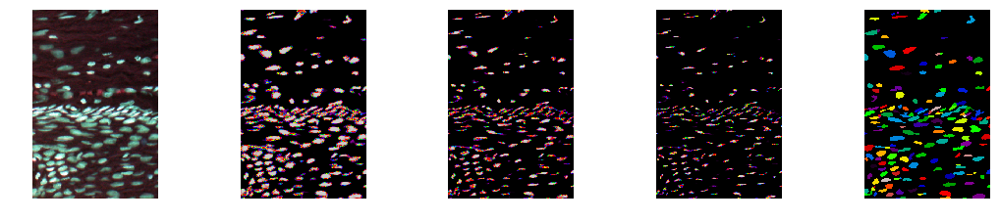

60


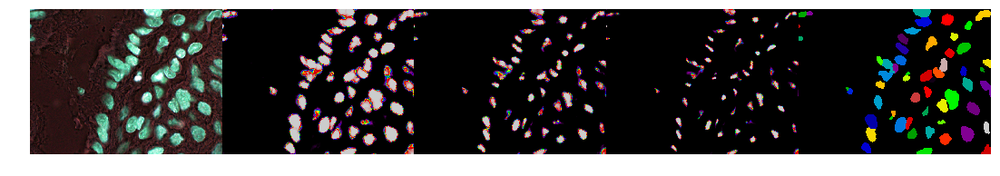

61


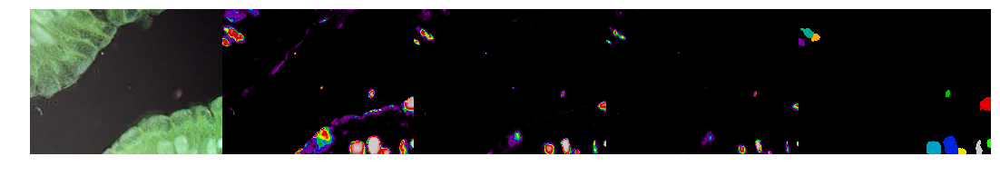

62


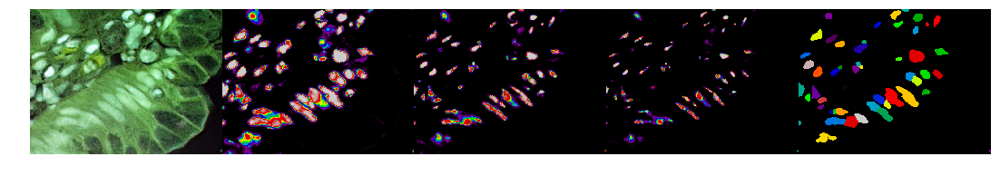

63


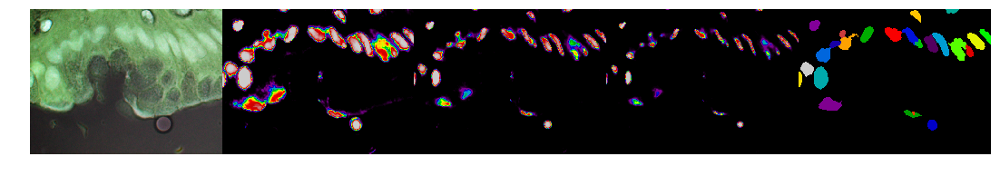

64


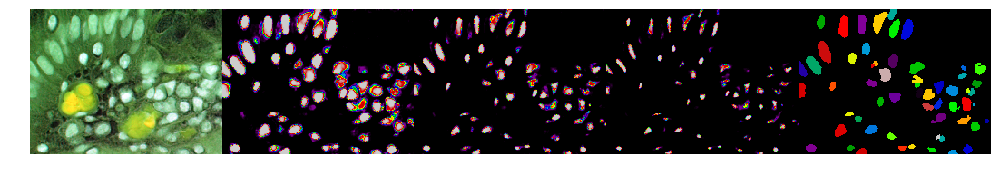

In [64]:
for i in range(len(test_images)):
    print(i)
    draw.plots([
      test_images[i],
      test_predictions[i][..., 0], 
      test_predictions[i][..., 1],
      test_predictions[i][..., 2],
      watershed(
        test_predictions[i], mask_threshold=0.5, center_threshold=0.7, width_holes=4, 
    width_objects=3, sigma=3, padding_size=5, min_size=16, footprint=np.ones((3, 3))
    ) * 12367 % 1000,
    ], scale=3, col_number=5)
    plt.show()

In [68]:
new_ids, rles = utils.mask2rle(test_predictions, test_names, lambda x: watershed(
        x, mask_threshold=0.5, center_threshold=0.7, width_holes=4, 
    width_objects=3, sigma=3, padding_size=5, min_size=16, footprint=np.ones((3, 3))
))

100%|██████████| 65/65 [00:02<00:00, 29.81it/s]


In [69]:
from datetime import datetime
sub = utils.make_submission(
    '../subs/{}.csv'.format(datetime.now()), new_ids, rles
)

In [70]:
sub.shape

(3666, 2)

In [56]:
state = torch.load(str('../../models/loss_cyclic_best_full.pt'))
model.load_state_dict(state['model'])